Group Members:

Asal Meskin 401106511

Danial Hosseintabar 401110472

Alireza Mirrokni 401106617

#import libraries

In [5]:
!pip install -q numpy
!pip install -q transformers[torch]
!pip install -q python-bidi
!pip install -q hazm
!pip install -q wordcloud-fa

In [6]:
import pandas as pd
import numpy as np
import string
import nltk
from nltk import word_tokenize
from sklearn.feature_extraction.text import TfidfVectorizer
import sklearn
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import spacy
import re
from hazm import Normalizer, word_tokenize, stopwords_list
import os
from wordcloud import WordCloud, STOPWORDS
from bidi import algorithm as bidi
import matplotlib.pyplot as plt
import seaborn as sns
from collections import Counter
import matplotlib.pyplot as plt
import string
from transformers import AutoTokenizer, AutoModelForSequenceClassification, TrainingArguments, Trainer
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix
import torch
from tqdm import tqdm
from sklearn.utils import resample
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings("ignore")

In [7]:
nltk.download('punkt')
nltk.download('stopwords')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True


# Exploratory Data Analysis (EDA) on Movie Dataset

The Exploratory Data Analysis (EDA) process is a crucial step to understand the characteristics and patterns present in a dataset. In this notebook, we'll perform EDA on a movie dataset to gain insights into various aspects such as genre distribution, release years, runtime, and ratings for both Persian and English language movies.

During the EDA process, we'll explore the dataset by:

1. Analyzing the genre distribution for Persian and English movies to identify popular genres.
2. Examining the release year trends for Persian and English movies to understand the distribution over time.
3. Investigating the runtime statistics for Persian and English movies to study the typical movie lengths.
4. Evaluating the rating distributions for Persian and English movies to gauge audience preferences.
...

The EDA process is iterative, and additional analyses may be required based on the insights gained from the initial exploration. The goal is to develop a comprehensive understanding of the dataset for both Persian and English language movies before proceeding with further analysis or modeling.

Feel free to explore the dataset creatively and provide any additional insights or visualizations that you find interesting or valuable. We encourage you to bring your unique perspective and creativity to enhance the EDA process.

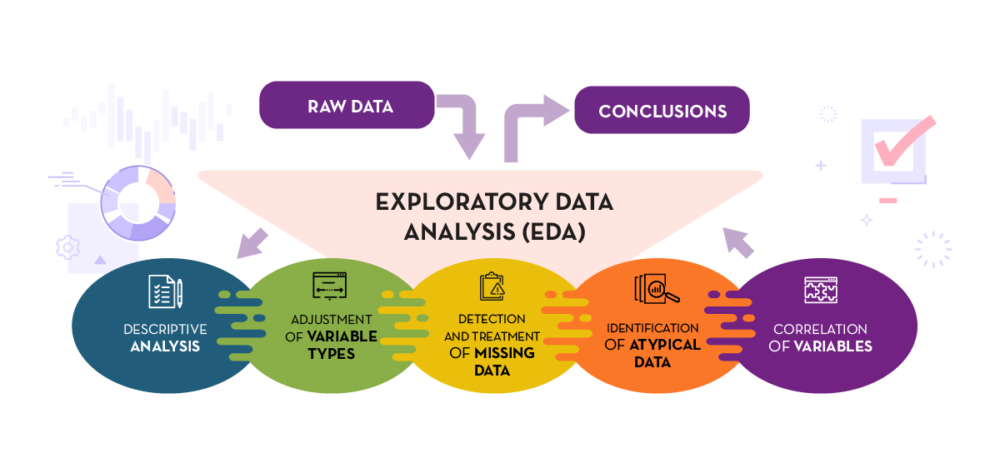

###1. **Data Preprocessing**:
   - Load the dataset
   - Check for missing values and handle them appropriately
   - Convert data types if necessary (e.g., string to datetime for release dates)
   - Create a new column called "preprocessed summary" where you perform the following steps and save the preprocessed summary in that column and later use it for the finetuning and analysis:
  *   Tokenize words
  *   Normalize text
  *   Remove punctuations
  *   Remove stopwords
  *   Removing HTML tags or markup
  *   Lemmatizing or stemming words
  *   Removing numbers or special characters
  *   Removing or replacing non-ASCII characters



In [8]:
# TODO: Load Dataset
df = pd.read_csv("persianmovies.csv")
df.rename(columns={'Content_1' : 'Persian Summary', 'Content_2' : 'English Summary'}, inplace=True)

print("Missing values before handling:")
print(df.isna().sum())
print("-" * 35)

df.dropna(inplace=True)

print("Missing values after handling:")
print(df.isna().sum())
print("-" * 35)

df['Year'] = df['Year'].astype('int64')
df['Time'] = df['Time'].astype('int64')
df['Score'] = df['Score'].astype('float64')
df['Genre'] = df['Genre'].astype('category')

display(df)

Missing values before handling:
Link                 0
EN_title             0
PENGLISH_title       5
PERSIAN_title        1
Persian Summary    361
English Summary    206
Score                0
Year                 0
Genre                0
Time                 8
dtype: int64
-----------------------------------
Missing values after handling:
Link               0
EN_title           0
PENGLISH_title     0
PERSIAN_title      0
Persian Summary    0
English Summary    0
Score              0
Year               0
Genre              0
Time               0
dtype: int64
-----------------------------------


,Link,EN_title,PENGLISH_title,PERSIAN_title,Persian Summary,English Summary,Score,Year,Genre,Time
0,https://www.imvbox.com/watch-persian-movie-ira...,Local Anaesthetic,Bi Hessie Mozeie,بی‌حسی موضعی,جلال‌، دانشجوی سابق رشته فلسفه، متوجه می‌شود خ...,"Jalal, a dropouts philosophy student, realizes...",4.8,2018,Drama,73
1,https://www.imvbox.com/watch-persian-movie-ira...,Disturbance,Ashoftegi,آشفته گی,«آشفته‌گی» رئالیستی و اجتماعی نیست. یک فیلم اس...,"After the murder of his rich twin brother, Bar...",3.8,2018,Crime,78
2,https://www.imvbox.com/watch-persian-movie-ira...,Highlight,Haylayt,هایلایت,یک تصادف اتومبیل آدم‌هایی را در تقابل با هم قر...,A man and a woman are have a car accident and ...,4.4,2017,Drama,77
3,https://www.imvbox.com/watch-persian-movie-ira...,Gilda,Geelda,گیلدا,گیلدا ماجرای زنی به نام «گیلدا» را روایت می کن...,Gilda who owns a restaurant has a terrible nig...,3.8,2018,Drama,79
4,https://www.imvbox.com/watch-persian-movie-ira...,Atmosphere Station,Istgahe Atmosfer,ایستگاه اتمسفر,این فیلم روایت گر داستان زندگی زوج جوانی به اس...,Vahid and Marjan are a young couple who have g...,5.6,2017,Drama,85
...,...,...,...,...,...,...,...,...,...,...
1430,https://www.imvbox.com/watch-persian-movie-ira...,The Postman,Postchi,پستچی,"""تقی پستچی "" برای پرداخت قروض خود مجبور است بع...","An impotent, nervous, unbalanced postman, havi...",8.7,1972,Drama,104
1431,https://www.imvbox.com/watch-persian-movie-ira...,Mr. Gullible,Aghaye Haloo,آقای هالو,مردی شهرستانی و ساده دل به قصد یافتن همسری منا...,A simple man from village goes to the big city...,9.3,1971,Comedy,113
1432,https://www.imvbox.com/watch-persian-movie-ira...,The Cow,Gav,گاو,"گاو ""مشهدی حسن "" می میرد و او که گاوش را خیلی ...",Often credited as being the first Iranian New ...,8.1,1969,Drama,100
1435,https://www.imvbox.com/watch-persian-movie-ira...,The Sicilian,Sisiliha,سیسیلی‌ها,سهراب به سیاوش که کلاهبردار است و عاشق ایتالیا...,Though he comes from a poor area south of Tehr...,5.4,2011,Crime,89


In [9]:
class English_Preprocessor:
    """
    A class for preprocessing text data.

    Attributes:
        stopwords (set): A set of stopwords to be removed from the text.
        nlp (spacy.lang.en.English): A SpaCy English language model for text normalization.

    Methods:
        preprocess(text): Performs preprocessing steps on the given text.
        normalize(text): Normalizes the given text by converting it to lowercase and lemmatizing the words.
        remove_punctuations(text): Removes punctuation from the given text.
        word_tokenize(text): Tokenizes the given text into individual words.
        remove_stopwords(words): Removes stopwords from the given list of words.
        **ADD MORE METHODS**
    """

    def __init__(self):
        """
        Initializes the Preprocessor object.

        TODO: Load the set of stopwords for the English language.
        TODO: Load the SpaCy English language model for text normalization.
        """
        self.stopwords = set(stopwords.words('english'))
        self.nlp = spacy.load("en_core_web_sm")

    def preprocess(self, text):
        """
        Preprocesses the given text by performing normalization, punctuation removal, word tokenization, and stopword removal.

        Args:
            text (str): The input text to be preprocessed.

        Returns:
            str: The preprocessed text.

        TODO: Implement the preprocess method by calling the respective helper methods in the correct order.
        """
        text1 = self.normalize(text)
        text2 = self.remove_punctuations(text1)
        text3 = self.word_tokenize(text2)
        text4 = " ".join(self.remove_stopwords(text3))

        return text4

    def normalize(self, text):
        """
        Normalizes the given text by converting it to lowercase and lemmatizing the words.

        Args:
            text (str): The input text to be normalized.

        Returns:
            str: The normalized text.

        TODO: Implement the normalize method using the SpaCy language model to lemmatize the words.
        """
        doc = self.nlp(text.lower())
        normalized_text = " ".join(token.lemma_ for token in doc)

        return normalized_text

    def remove_punctuations(self, text):
        """
        Removes punctuation from the given text.

        Args:
            text (str): The input text from which punctuation needs to be removed.

        Returns:
            str: The text with punctuation removed.

        TODO: Implement the remove_punctuations method using regular expressions.
        """
        filtered_text = re.sub(r'[^\w\s]', '', text)

        return filtered_text

    def word_tokenize(self, text):
        """
        Tokenizes the given text into individual words.

        Args:
            text (str): The input text to be tokenized.

        Returns:
            list: A list of tokens (words) in the text.

        TODO: Implement the word_tokenize method using the NLTK word_tokenize function.
        """
        tokens = nltk.word_tokenize(text)

        return tokens

    def remove_stopwords(self, words):
        """
        Removes stopwords from the given list of words.

        Args:
            words (list): A list of words from which stopwords need to be removed.

        Returns:
            list: A list of words with stopwords removed.

        TODO: Implement the remove_stopwords method by filtering out words present in the stopwords set.
        """
        filtered_words = [word for word in words if word not in self.stopwords]

        return filtered_words

In [10]:
# TODO: Apply the preprocess method of the Preprocessor object to the English Summary column of the DataFrame
# and store the preprocessed text in a new column named 'Preprocessed English'.
# TODO: Display the updated DataFrame with the new 'Preprocessed English' column.
english_preprocessor =  English_Preprocessor()
df['Preprocessed English'] = [english_preprocessor.preprocess(df.loc[row, 'English Summary']) for row in list(df.index)]
display(df)

,Link,EN_title,PENGLISH_title,PERSIAN_title,Persian Summary,English Summary,Score,Year,Genre,Time,Preprocessed English
0,https://www.imvbox.com/watch-persian-movie-ira...,Local Anaesthetic,Bi Hessie Mozeie,بی‌حسی موضعی,جلال‌، دانشجوی سابق رشته فلسفه، متوجه می‌شود خ...,"Jalal, a dropouts philosophy student, realizes...",4.8,2018,Drama,73,jalal dropout philosophy student realize siste...
1,https://www.imvbox.com/watch-persian-movie-ira...,Disturbance,Ashoftegi,آشفته گی,«آشفته‌گی» رئالیستی و اجتماعی نیست. یک فیلم اس...,"After the murder of his rich twin brother, Bar...",3.8,2018,Crime,78,murder rich twin brother barbod assume identit...
2,https://www.imvbox.com/watch-persian-movie-ira...,Highlight,Haylayt,هایلایت,یک تصادف اتومبیل آدم‌هایی را در تقابل با هم قر...,A man and a woman are have a car accident and ...,4.4,2017,Drama,77,man woman car accident go coma spouse know two...
3,https://www.imvbox.com/watch-persian-movie-ira...,Gilda,Geelda,گیلدا,گیلدا ماجرای زنی به نام «گیلدا» را روایت می کن...,Gilda who owns a restaurant has a terrible nig...,3.8,2018,Drama,79,gilda restaurant terrible night till morning s...
4,https://www.imvbox.com/watch-persian-movie-ira...,Atmosphere Station,Istgahe Atmosfer,ایستگاه اتمسفر,این فیلم روایت گر داستان زندگی زوج جوانی به اس...,Vahid and Marjan are a young couple who have g...,5.6,2017,Drama,85,vahid marjan young couple get divorce month ag...
...,...,...,...,...,...,...,...,...,...,...,...
1430,https://www.imvbox.com/watch-persian-movie-ira...,The Postman,Postchi,پستچی,"""تقی پستچی "" برای پرداخت قروض خود مجبور است بع...","An impotent, nervous, unbalanced postman, havi...",8.7,1972,Drama,104,impotent nervous unbalanced postman beautiful ...
1431,https://www.imvbox.com/watch-persian-movie-ira...,Mr. Gullible,Aghaye Haloo,آقای هالو,مردی شهرستانی و ساده دل به قصد یافتن همسری منا...,A simple man from village goes to the big city...,9.3,1971,Comedy,113,simple man village go big city tehran find job...
1432,https://www.imvbox.com/watch-persian-movie-ira...,The Cow,Gav,گاو,"گاو ""مشهدی حسن "" می میرد و او که گاوش را خیلی ...",Often credited as being the first Iranian New ...,8.1,1969,Drama,100,often credit first iranian new wave film cow w...
1435,https://www.imvbox.com/watch-persian-movie-ira...,The Sicilian,Sisiliha,سیسیلی‌ها,سهراب به سیاوش که کلاهبردار است و عاشق ایتالیا...,Though he comes from a poor area south of Tehr...,5.4,2011,Crime,89,though come poor area south tehran sia always ...


In [11]:
from hazm import Normalizer, word_tokenize, stopwords_list

# TODO: Initialize the HAZM Normalizer
# TODO: Load the Persian stopwords list
# TODO: Load desired functions from HAZM (or any other library)
normalizer = Normalizer()
persian_stopwords = stopwords_list()

def persian_preprocess_text(text):
    """
    Preprocesses the given Persian text by performing normalization, punctuation removal, word tokenization, and stopword removal.

    Args:
        text (str): The input Persian text to be preprocessed.

    Returns:
        str: The preprocessed Persian text.

    TODO: Implement the following steps:
    1. Remove punctuations from the text using regular expressions.
    2. Normalize the text using the HAZM Normalizer.
    3. Tokenize the normalized text using the HAZM word_tokenize function.
    4. Remove stopwords from the tokenized text using the loaded stopwords list.
    5. Join the remaining tokens back into a string.
    6. ... (what other preprocessing methods you want to have)
    """
    filtered_text = re.sub(r'[^\w\s]', '', text)
    normalized_text = normalizer.normalize(filtered_text)
    words = word_tokenize(normalized_text)
    filtered_words = [word for word in words if word not in persian_stopwords]
    processed_text = " ".join(filtered_words)

    return processed_text

# TODO: Apply the persian_preprocess_text function to the Persian Summary column of the DataFrame
# and store the preprocessed text in a new column named 'Preprocessed Persian'.
# TODO: Display the updated DataFrame with the new 'Preprocessed Persian' column.
df['Preprocessed Persian'] = [persian_preprocess_text(df.loc[row, 'Persian Summary']) for row in list(df.index)]
display(df)

,Link,EN_title,PENGLISH_title,PERSIAN_title,Persian Summary,English Summary,Score,Year,Genre,Time,Preprocessed English,Preprocessed Persian
0,https://www.imvbox.com/watch-persian-movie-ira...,Local Anaesthetic,Bi Hessie Mozeie,بی‌حسی موضعی,جلال‌، دانشجوی سابق رشته فلسفه، متوجه می‌شود خ...,"Jalal, a dropouts philosophy student, realizes...",4.8,2018,Drama,73,jalal dropout philosophy student realize siste...,جلال دانشجوی سابق رشته فلسفه متوجه میشود خواهر...
1,https://www.imvbox.com/watch-persian-movie-ira...,Disturbance,Ashoftegi,آشفته گی,«آشفته‌گی» رئالیستی و اجتماعی نیست. یک فیلم اس...,"After the murder of his rich twin brother, Bar...",3.8,2018,Crime,78,murder rich twin brother barbod assume identit...,آشفتهگی رئالیستی اجتماعی فیلم عشق جنایت
2,https://www.imvbox.com/watch-persian-movie-ira...,Highlight,Haylayt,هایلایت,یک تصادف اتومبیل آدم‌هایی را در تقابل با هم قر...,A man and a woman are have a car accident and ...,4.4,2017,Drama,77,man woman car accident go coma spouse know two...,تصادف اتومبیل آدمهایی تقابل قرار میدهد مراقبت ...
3,https://www.imvbox.com/watch-persian-movie-ira...,Gilda,Geelda,گیلدا,گیلدا ماجرای زنی به نام «گیلدا» را روایت می کن...,Gilda who owns a restaurant has a terrible nig...,3.8,2018,Drama,79,gilda restaurant terrible night till morning s...,گیلدا ماجرای زنی نام گیلدا روایت صاحب رستوانیس...
4,https://www.imvbox.com/watch-persian-movie-ira...,Atmosphere Station,Istgahe Atmosfer,ایستگاه اتمسفر,این فیلم روایت گر داستان زندگی زوج جوانی به اس...,Vahid and Marjan are a young couple who have g...,5.6,2017,Drama,85,vahid marjan young couple get divorce month ag...,فیلم روایت‌گر داستان زندگی زوج جوانی اسم مرجان...
...,...,...,...,...,...,...,...,...,...,...,...,...
1430,https://www.imvbox.com/watch-persian-movie-ira...,The Postman,Postchi,پستچی,"""تقی پستچی "" برای پرداخت قروض خود مجبور است بع...","An impotent, nervous, unbalanced postman, havi...",8.7,1972,Drama,104,impotent nervous unbalanced postman beautiful ...,تقی پستچی پرداخت قروض مجبور ظهرها نزد نیت الله...
1431,https://www.imvbox.com/watch-persian-movie-ira...,Mr. Gullible,Aghaye Haloo,آقای هالو,مردی شهرستانی و ساده دل به قصد یافتن همسری منا...,A simple man from village goes to the big city...,9.3,1971,Comedy,113,simple man village go big city tehran find job...,مردی شهرستانی ساده دل قصد یافتن همسری تهران ته...
1432,https://www.imvbox.com/watch-persian-movie-ira...,The Cow,Gav,گاو,"گاو ""مشهدی حسن "" می میرد و او که گاوش را خیلی ...",Often credited as being the first Iranian New ...,8.1,1969,Drama,100,often credit first iranian new wave film cow w...,گاو مشهدی حسن می‌میرد گاوش دوست متدرجا قالب گا...
1435,https://www.imvbox.com/watch-persian-movie-ira...,The Sicilian,Sisiliha,سیسیلی‌ها,سهراب به سیاوش که کلاهبردار است و عاشق ایتالیا...,Though he comes from a poor area south of Tehr...,5.4,2011,Crime,89,though come poor area south tehran sia always ...,سهراب سیاوش کلاهبردار عاشق ایتالیاست سیا سیسیل...


### 2. **Descriptive Statistics**:
   - Calculate summary statistics (mean, median, mode, standard deviation, range) for numerical variables
   - Determine the count and frequency of unique values for categorical variables

In [12]:

# Feel free to add any desired methods to the class below this is a suggestion.

class DescriptiveStats:
    def __init__(self, df):
        self.df = df

    def calculate_summary_stats(self, numerical_cols):
        """
        Calculate summary statistics (mean, median, mode, standard deviation, range) for numerical variables.

        Args:
            numerical_cols (list): A list of column names containing numerical data.

        Returns:
            None (prints the summary statistics for each numerical column)

        TODO:
        1. Ensure that the specified columns are treated as numerical data types.
        2. Calculate and print the mean, median, mode, standard deviation, and range for each numerical column.
        """
        for col in numerical_cols:
            if col in self.df.columns:
                self.df[col] = pd.to_numeric(self.df[col], errors='coerce')

                if pd.api.types.is_numeric_dtype(self.df[col]):
                    mean_val = self.df[col].mean()
                    median_val = self.df[col].median()
                    mode_val = self.df[col].mode().iloc[0]
                    std_val = self.df[col].std()
                    min_val = self.df[col].min()
                    max_val = self.df[col].max()

                    print(f"Column: {col}")
                    print(f"  Mean: {mean_val:.2f}")
                    print(f"  Median: {median_val}")
                    print(f"  Mode: {mode_val}")
                    print(f"  Standard Deviation: {std_val:.2f}")
                    print(f"  Range: ({min_val}, {max_val})")
                    print("-" * 30)
                else:
                    print(f"Column '{col}' is not numeric.")
            else:
                print(f"Column '{col}' not found in the DataFrame.")

    def count_unique_values(self, categorical_cols):
        """
        Determine the count and frequency of unique values for categorical variables.

        Args:
            categorical_cols (list): A list of column names containing categorical data.

        Returns:
            None (prints the count and frequency of unique values for each categorical column)

        TODO:
        1. Iterate through each categorical column.
        2. Calculate the count and frequency of unique values for each column.
        3. Print the unique values, their counts, and their frequencies.
        """
        for col in categorical_cols:
            if col in self.df.columns:
                unique_values = self.df[col].unique()
                value_counts = self.df[col].value_counts()

                print(f"Column: {col}")

                for value in unique_values:
                    count = value_counts.get(value, 0)
                    frequency = count / len(self.df) * 100
                    print(f"  {value}: Count={count}, Frequency={frequency:.2f}%")
                print("-" * 30)
            else:
                print(f"Column '{col}' not found in the DataFrame.")

# Example usage
numerical_cols = df.select_dtypes(include=['number'])
categorical_cols = df.select_dtypes(include=['category'])

# Assuming you have a pandas DataFrame named 'df'
stats = DescriptiveStats(df)

# TODO: Call the calculate_summary_stats method with the numerical_cols list
stats.calculate_summary_stats(numerical_cols)

# TODO: Call the count_unique_values method with the categorical_cols list
stats.count_unique_values(categorical_cols)

Column: Score
  Mean: 6.37
  Median: 6.6
  Mode: 8.0
  Standard Deviation: 1.55
  Range: (0.0, 10.0)
------------------------------
Column: Year
  Mean: 2006.57
  Median: 2008.0
  Mode: 2017
  Standard Deviation: 9.95
  Range: (1969, 2020)
------------------------------
Column: Time
  Mean: 90.96
  Median: 90.0
  Mode: 90
  Standard Deviation: 12.17
  Range: (38, 178)
------------------------------
Column: Genre
  Drama: Count=537, Frequency=57.93%
  Crime: Count=46, Frequency=4.96%
  Human Interest & Society: Count=8, Frequency=0.86%
  Comedy: Count=177, Frequency=19.09%
  Adventure: Count=37, Frequency=3.99%
  Mystery: Count=4, Frequency=0.43%
  War: Count=16, Frequency=1.73%
  Action: Count=56, Frequency=6.04%
  Portrait: Count=1, Frequency=0.11%
  Experimental: Count=2, Frequency=0.22%
  Family: Count=17, Frequency=1.83%
  Romance: Count=6, Frequency=0.65%
  History: Count=7, Frequency=0.76%
  Animation: Count=1, Frequency=0.11%
  Arts & Literature: Count=3, Frequency=0.32%
  Horro

###3. **Data Visualization**:
   - Plot histograms or density plots for numerical variables
   - Create bar plots or pie charts for categorical variables
   - Generate scatter plots or correlation matrices to explore relationships

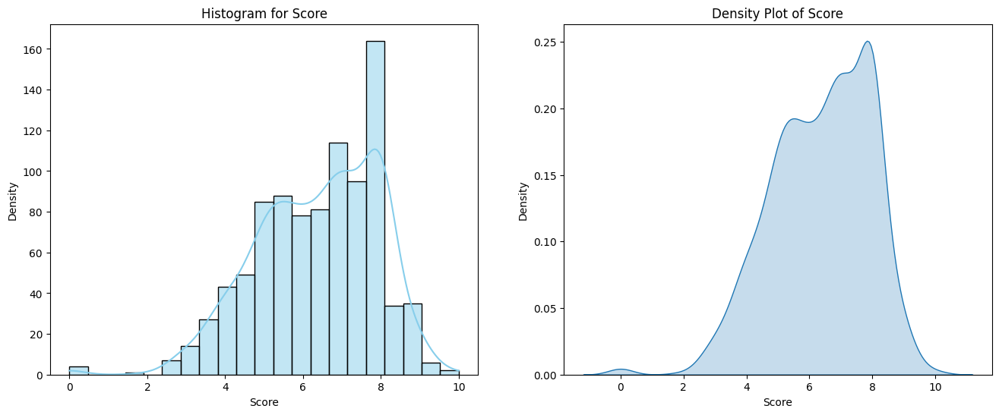

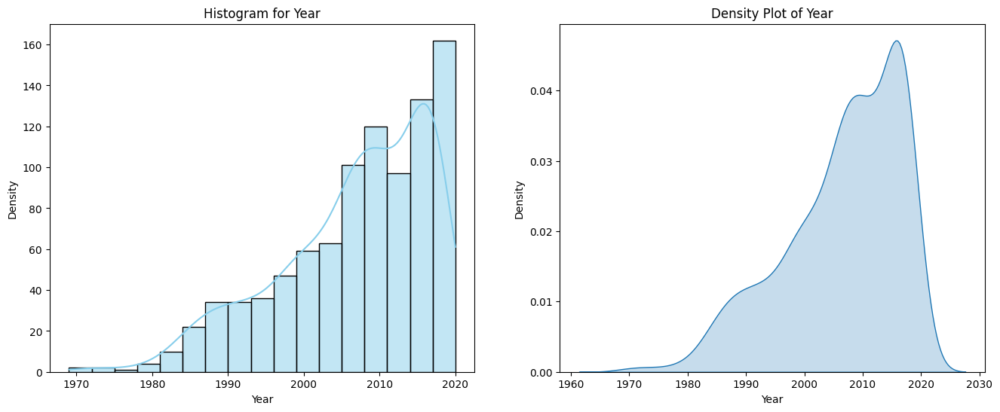

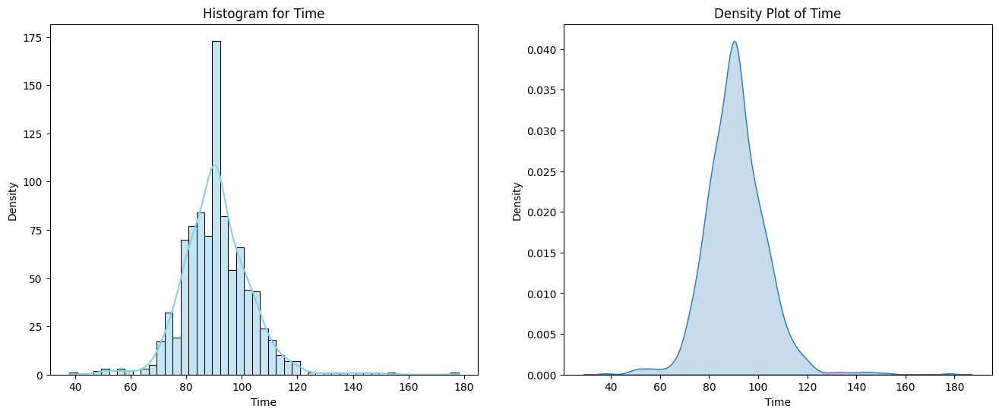

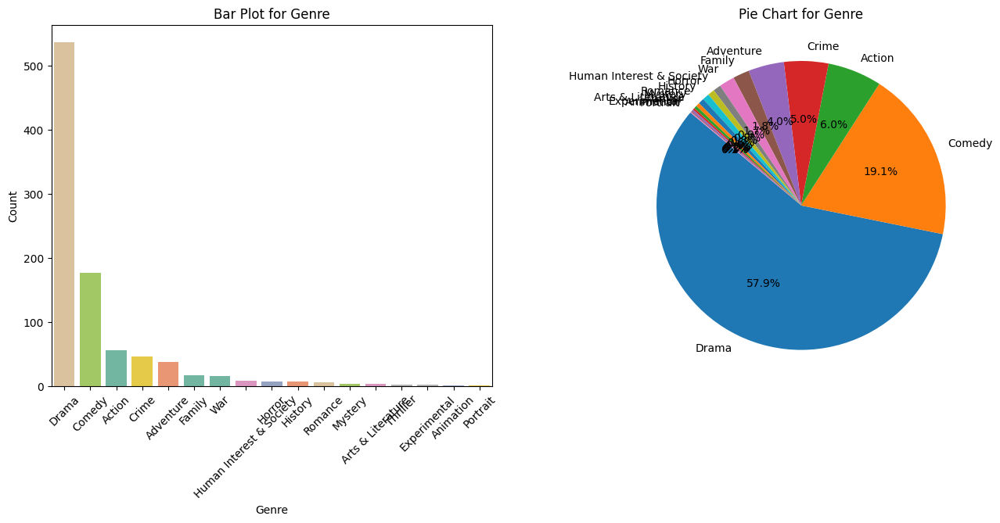

<Figure size 800x600 with 0 Axes>

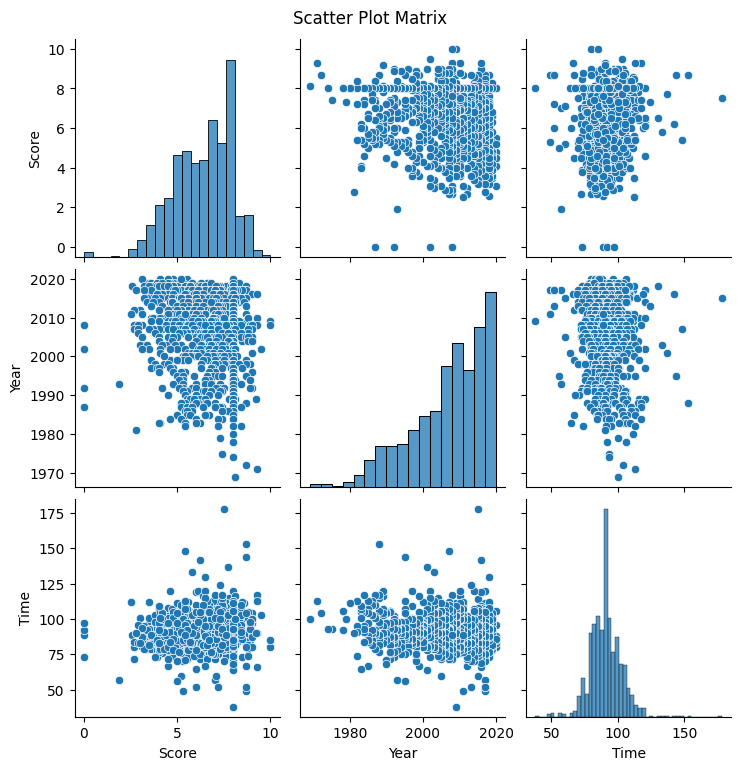

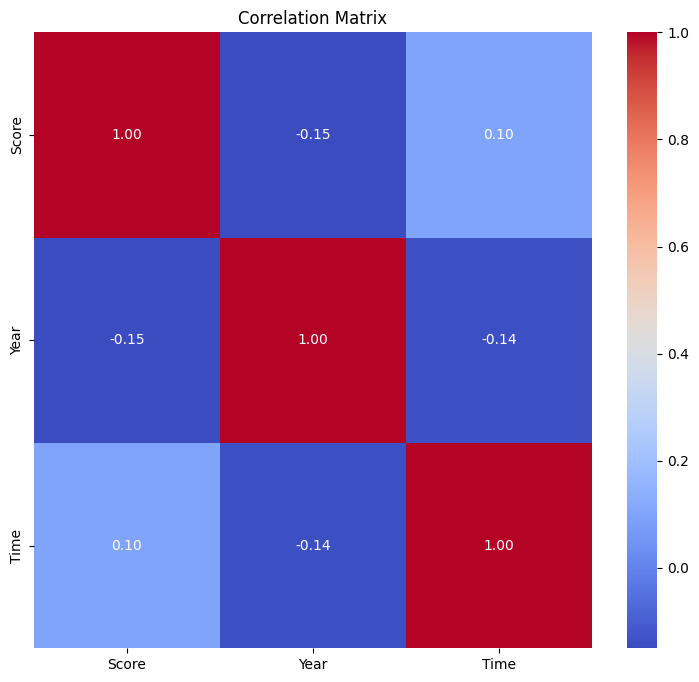

In [13]:
import matplotlib.pyplot as plt
import seaborn as sns

# Feel free to add any desired methods to the class below this is a suggestion.
# Have fun trying to visualize your data

class DataVisualization:
    def __init__(self, df):
        self.df = df

    def plot_histograms(self, numerical_cols):
        """
        Plot histograms or density plots for numerical variables.

        Args:
            numerical_cols (list): A list of column names containing numerical data.

        Returns:
            None (displays the plots)

        TODO:
        1. Iterate through each numerical column.
        2. Create a histogram or density plot for each column using Matplotlib or Seaborn.
        3. Set appropriate titles and labels for the plots.
        4. Display the plots.
        """
        for col in numerical_cols:
            plt.figure(figsize=(16, 6))

            plt.subplot(1, 2, 1)
            sns.histplot(self.df[col], kde=True, color='skyblue')
            plt.title(f'Histogram for {col}')
            plt.xlabel(col)
            plt.ylabel('Density')

            plt.subplot(1, 2, 2)
            sns.kdeplot(self.df[col], shade=True)
            plt.title(f'Density Plot of {col}')
            plt.xlabel(col)
            plt.ylabel('Density')
            plt.show()

    def plot_categorical(self, categorical_cols):
        """
        Create bar plots or pie charts for categorical variables.

        Args:
            categorical_cols (list): A list of column names containing categorical data.

        Returns:
            None (displays the plots)

        TODO:
        1. Iterate through each categorical column.
        2. Create a bar plot or pie chart for each column using Matplotlib or Seaborn.
        3. Set appropriate titles and labels for the plots.
        4. Display the plots.
        """
        for col in categorical_cols:
            plt.figure(figsize=(16, 6))

            plt.subplot(1, 2, 1)
            sns.countplot(x=col, hue=col, data=self.df, palette='Set2', legend=False, order=self.df[col].value_counts().index)
            plt.title(f'Bar Plot for {col}')
            plt.xlabel(col)
            plt.ylabel('Count')
            plt.xticks(rotation=45)

            plt.subplot(1, 2, 2)
            self.df[col].value_counts().plot(kind='pie', autopct='%1.1f%%', startangle=140)
            plt.title(f'Pie Chart for {col}')
            plt.ylabel('')
            plt.show()
            plt.show()


    def plot_relationships(self, numerical_cols):
        """
        Generate scatter plots or correlation matrices to explore relationships between numerical variables.

        Args:
            numerical_cols (list): A list of column names containing numerical data.

        Returns:
            None (displays the plots)

        TODO:
        1. Create a scatter plot matrix or correlation matrix for the numerical columns using Matplotlib or Seaborn.
        2. Set appropriate titles and labels for the plots.
        3. Display the plots.
        """
        plt.figure(figsize=(8, 6))
        sns.pairplot(self.df[numerical_cols])
        plt.suptitle('Scatter Plot Matrix', y=1.02)
        plt.show()

        plt.figure(figsize=(9, 8))
        corr_matrix = self.df[numerical_cols].corr()
        sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
        plt.title("Correlation Matrix")
        plt.show()

# Example usage
numerical_cols = df.select_dtypes(include=['number'])
categorical_cols = df.select_dtypes(include=['category'])

# Assuming you have a pandas DataFrame named 'df'
viz = DataVisualization(df)

# TODO: Call the plot_histograms method with the numerical_cols list
viz.plot_histograms(numerical_cols)

# TODO: Call the plot_categorical method with the categorical_cols list
viz.plot_categorical(categorical_cols)

# TODO: Call the plot_relationships method with the numerical_cols list
viz.plot_relationships(numerical_cols.columns.tolist())

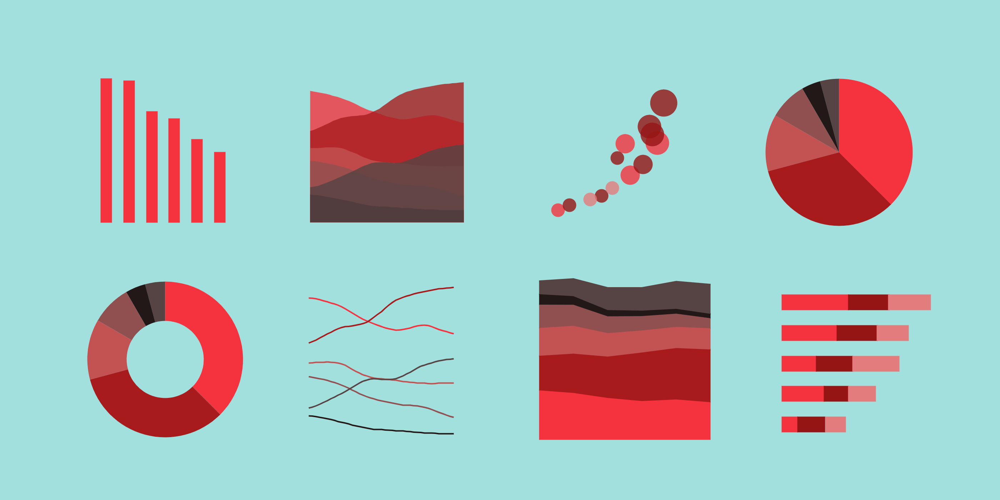

###4. **Genre Analysis**:
   - Create a word cloud or bar plot for genre distribution (you can use bidi library for persian text)
   - Obtain the 10 most frequently occurring words for each genre, based on both the initial summaries and the preprocessed summaries.
   - Analyze the distribution of movies across genres
   - Explore the relationship between genres and other variables

Drama


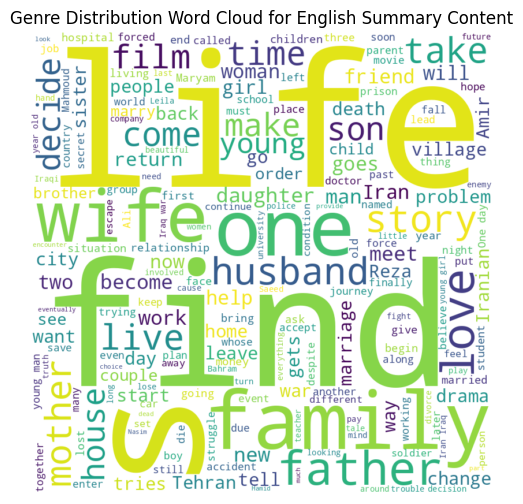

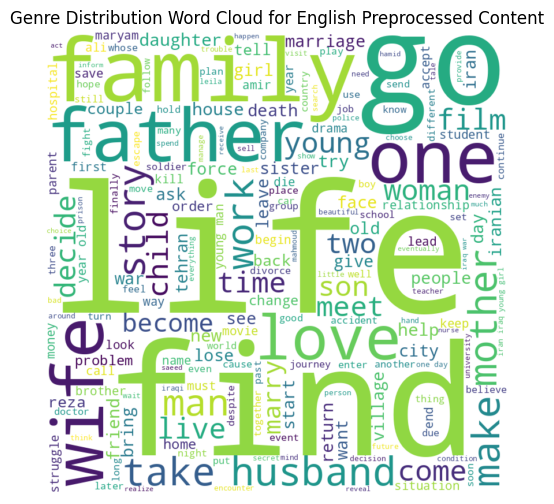

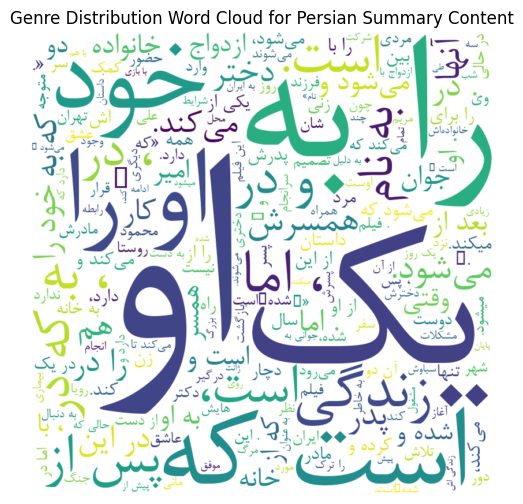

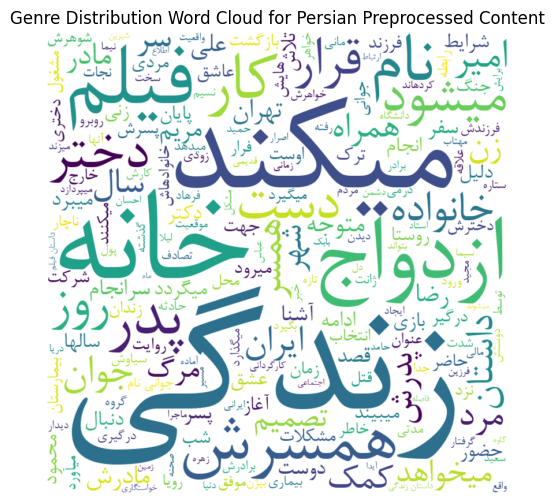

Crime


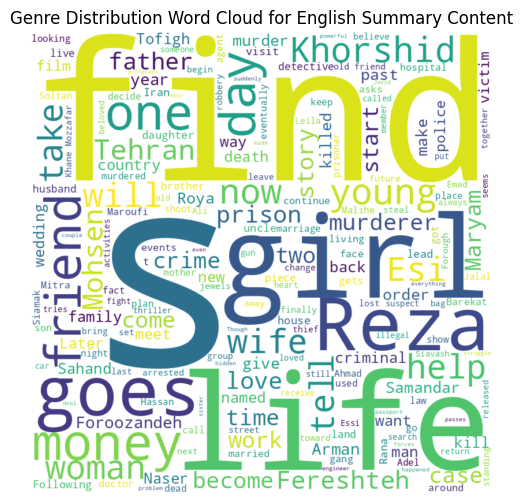

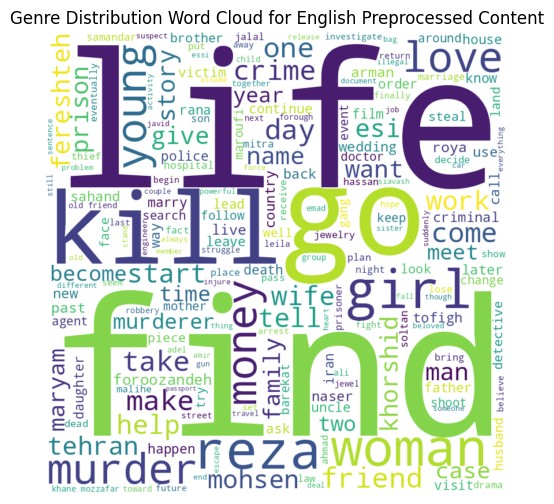

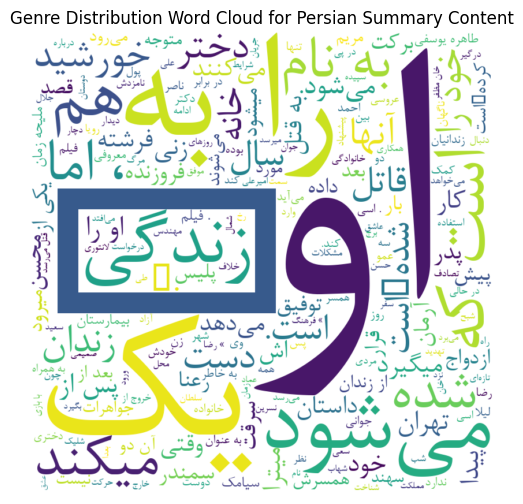

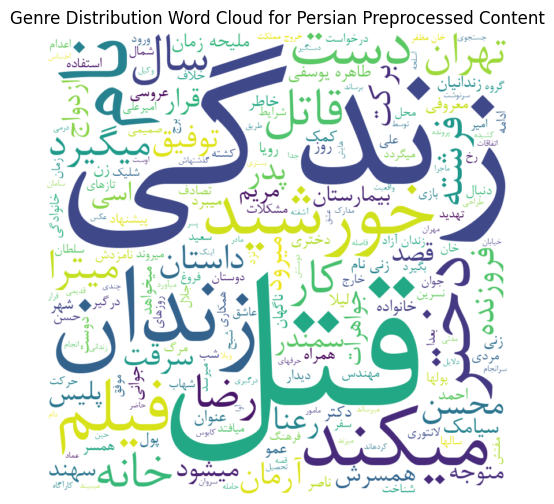

Human Interest & Society


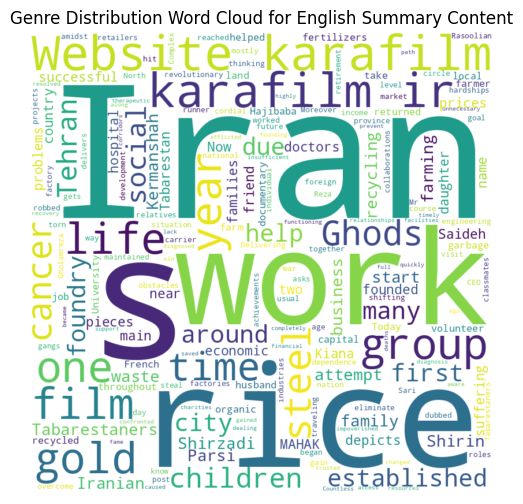

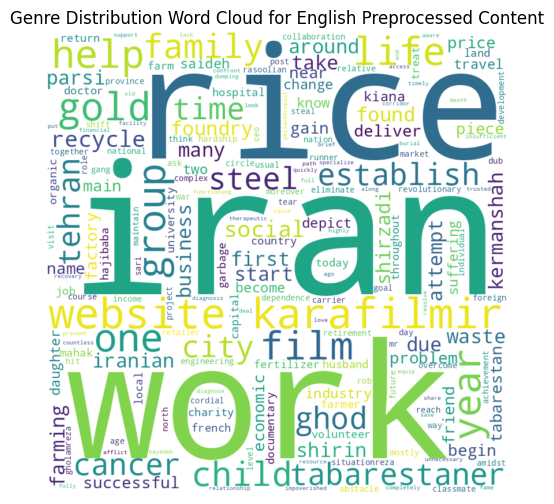

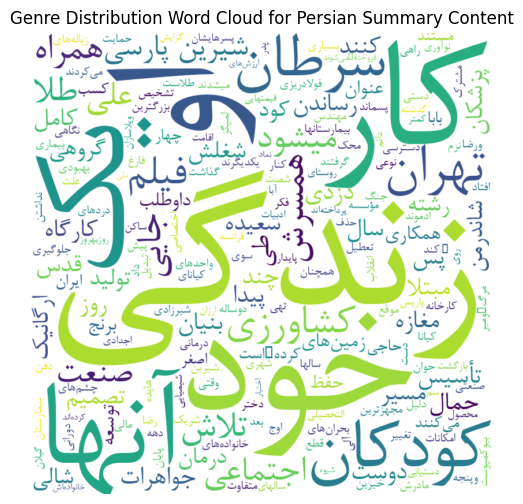

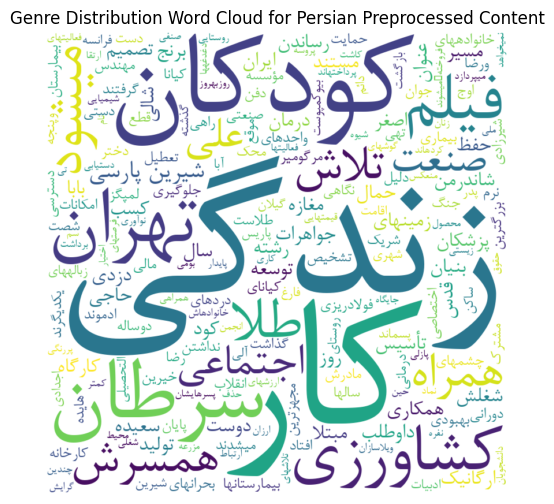

Comedy


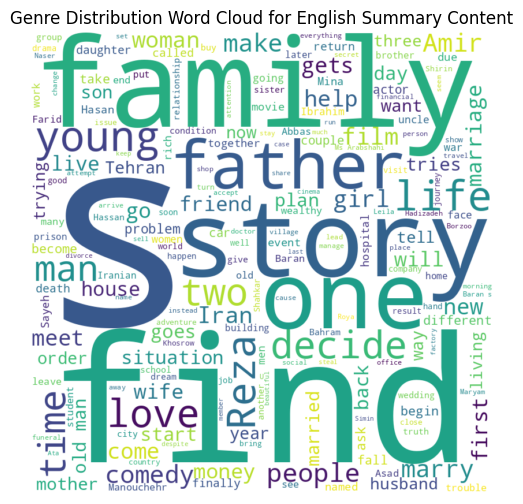

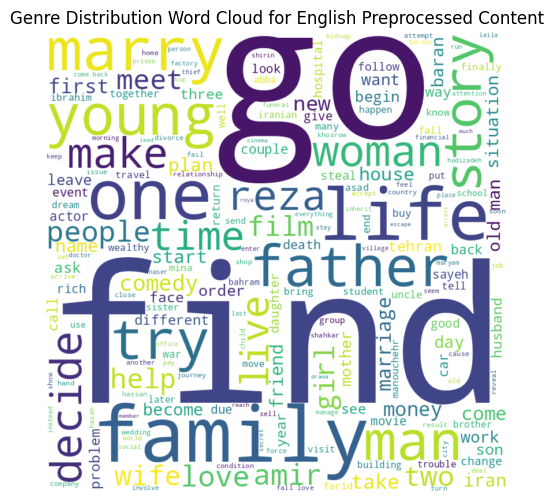

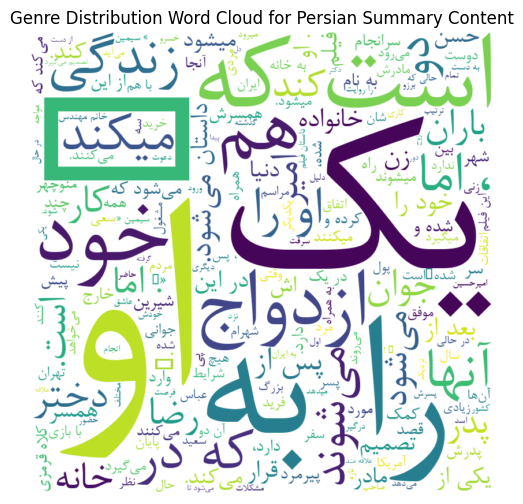

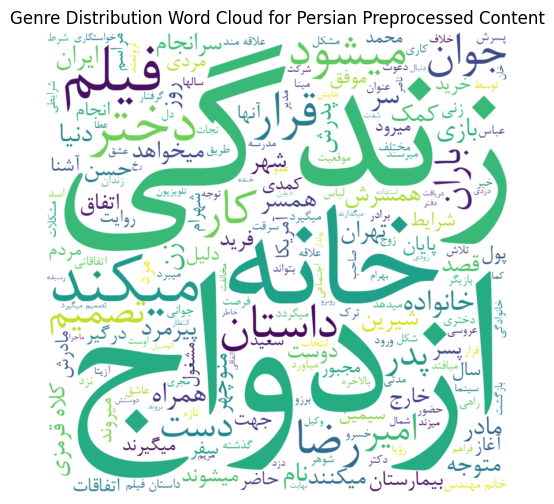

Adventure


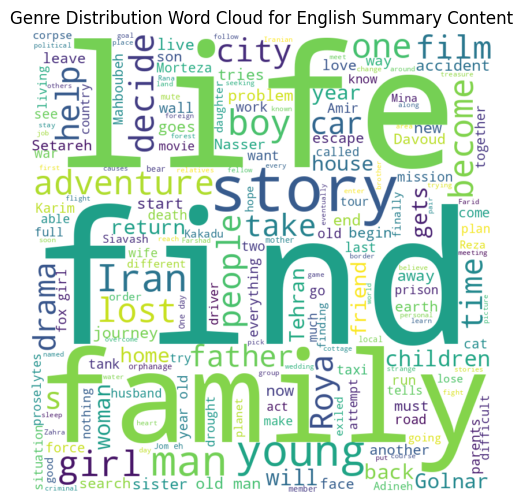

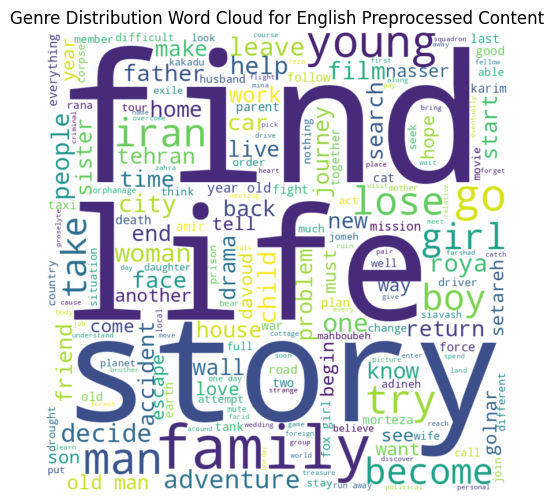

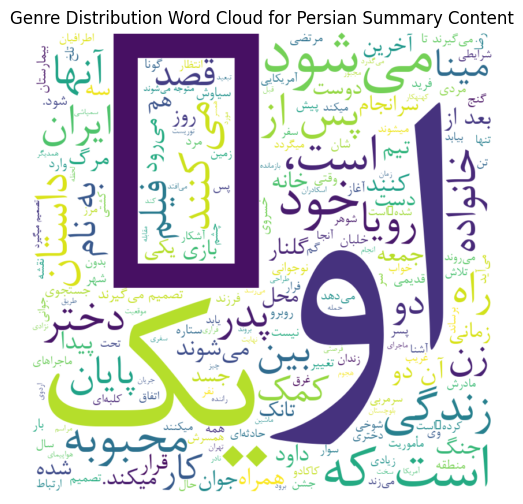

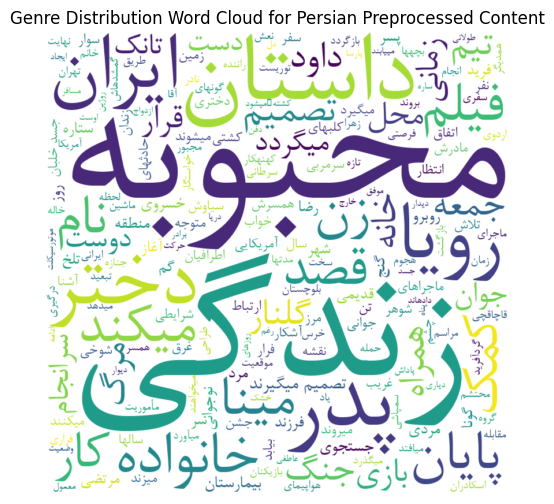

Mystery


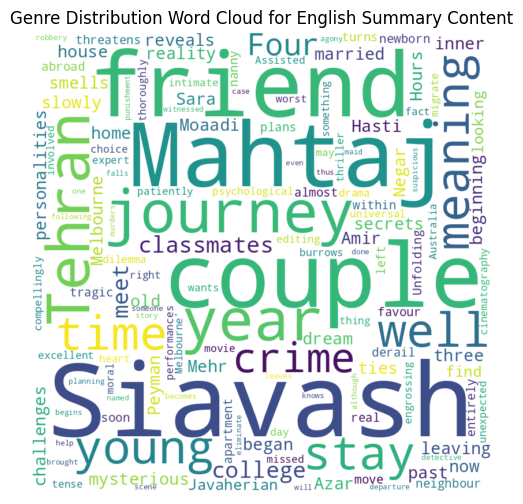

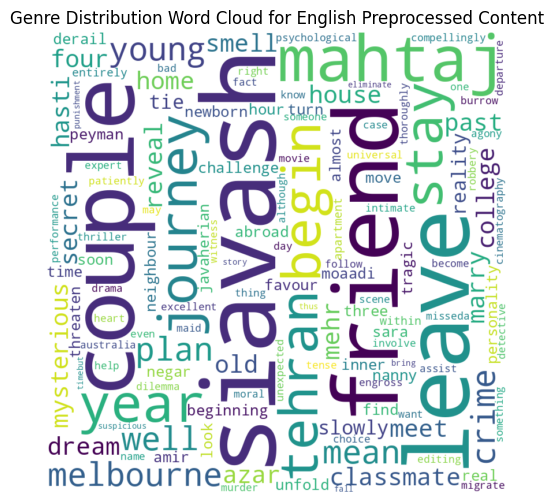

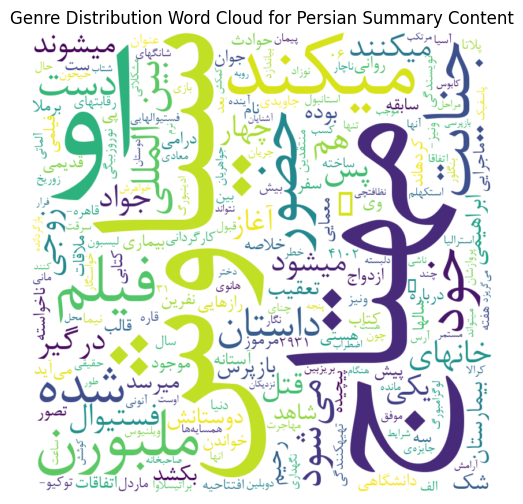

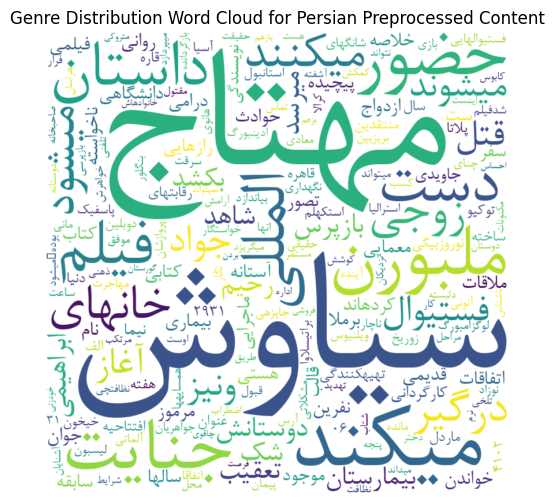

War


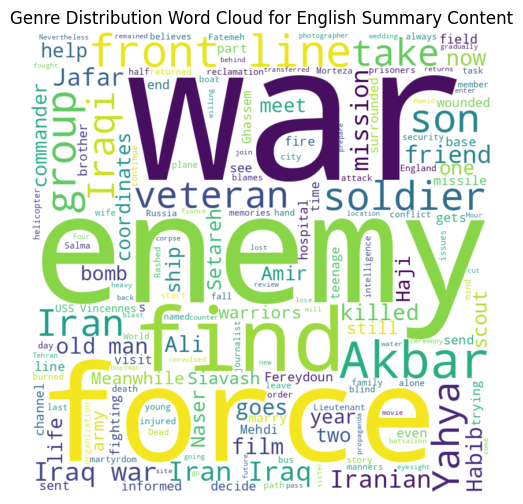

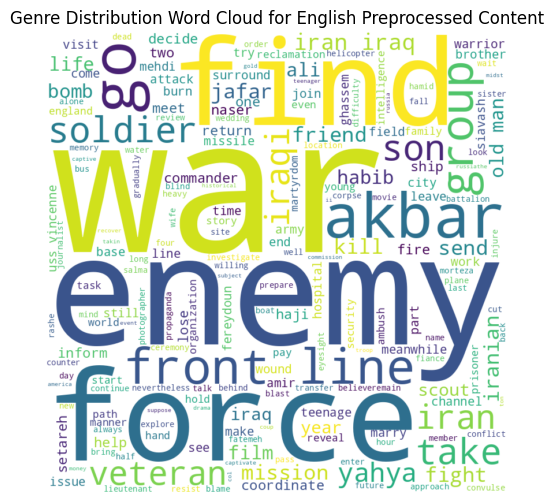

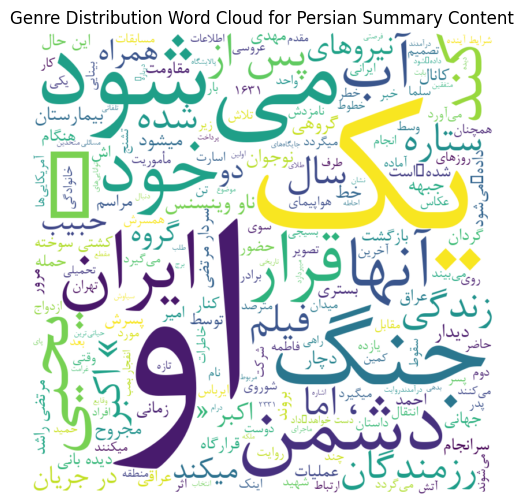

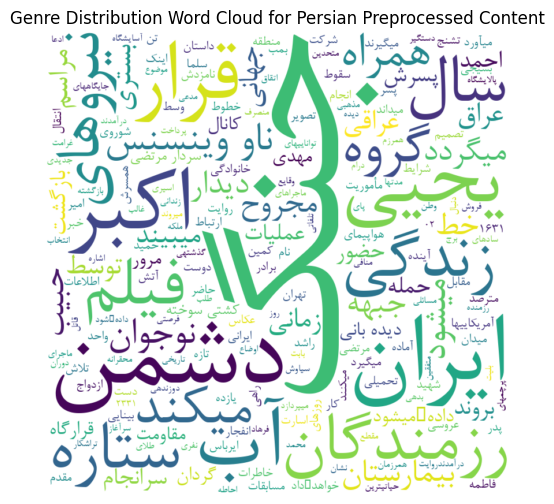

Action


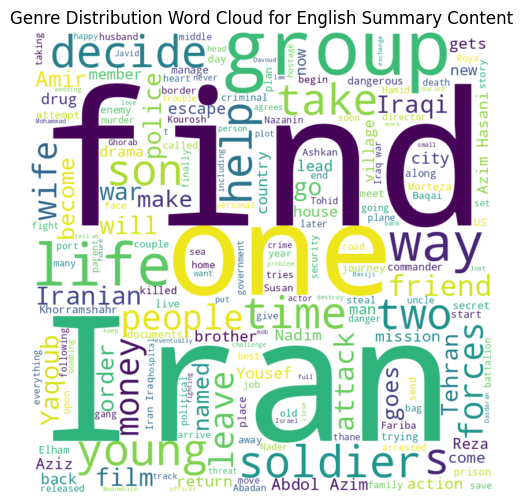

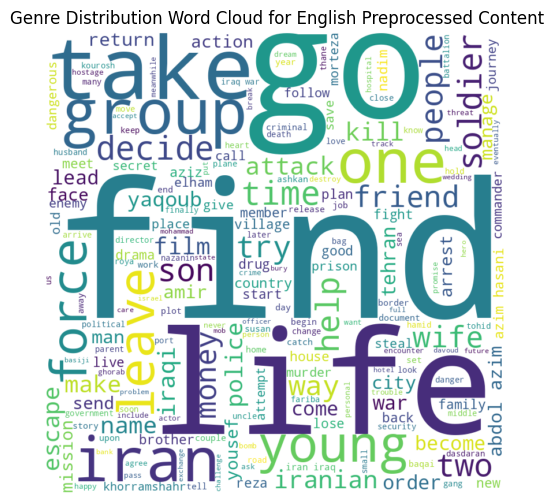

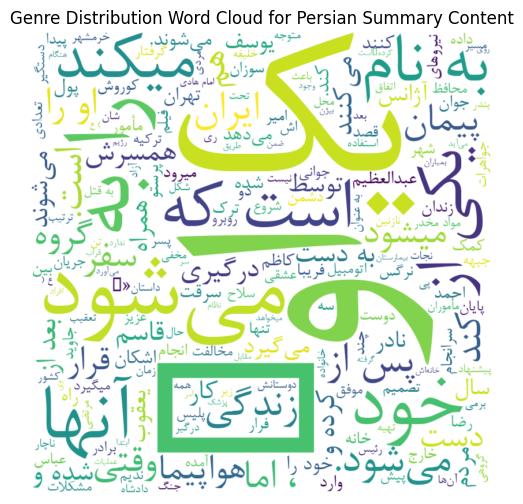

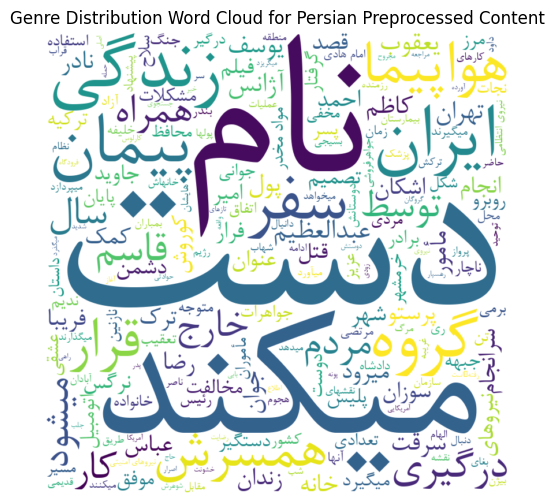

Portrait


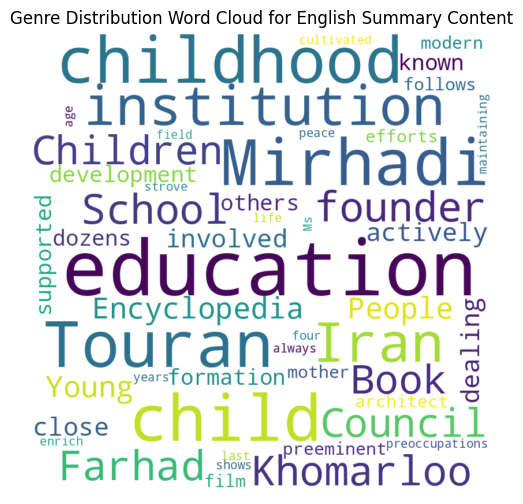

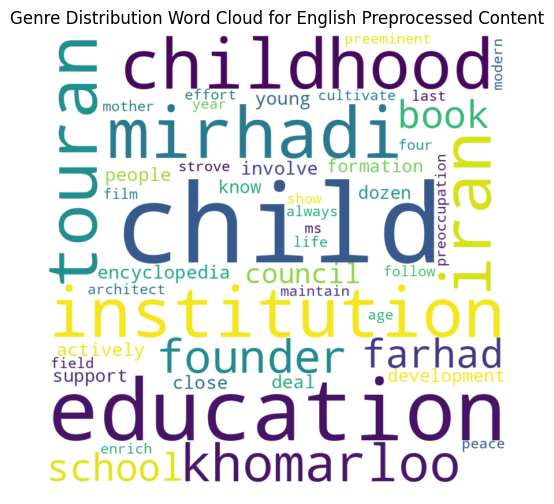

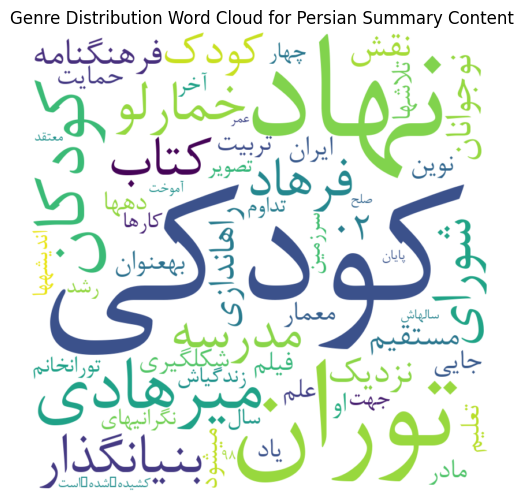

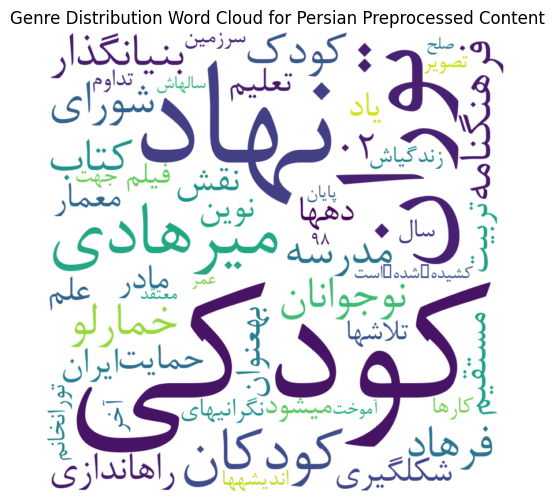

Experimental


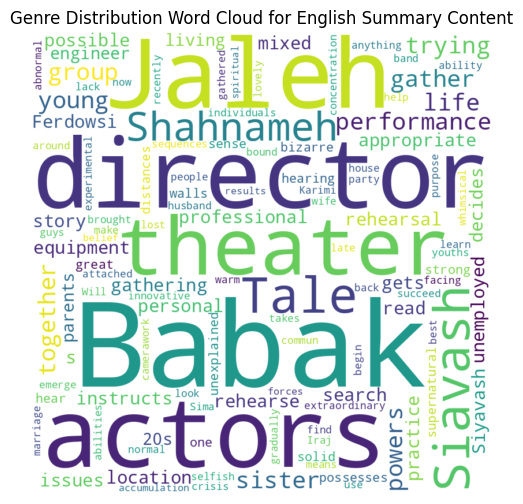

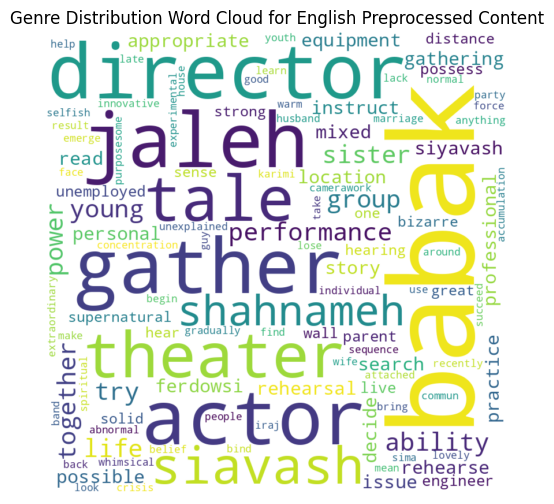

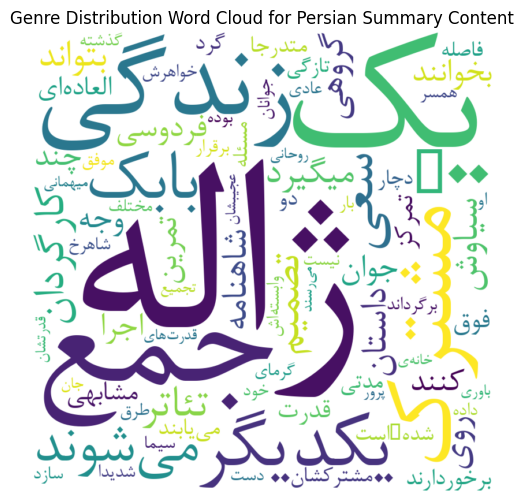

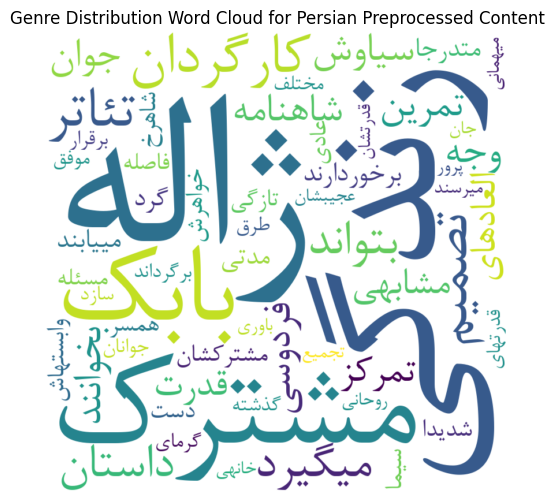

Family


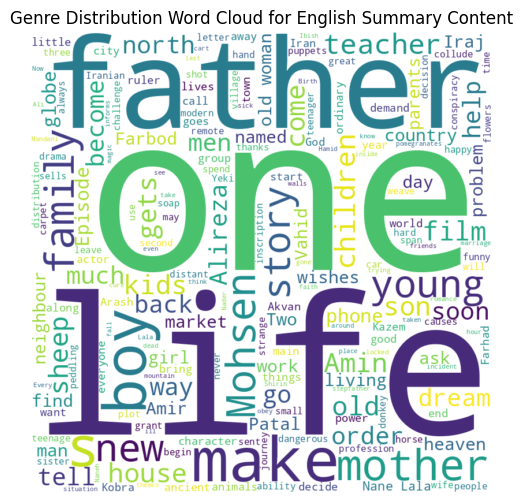

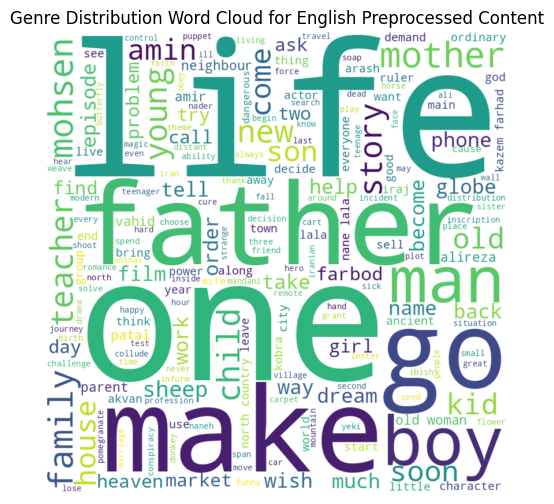

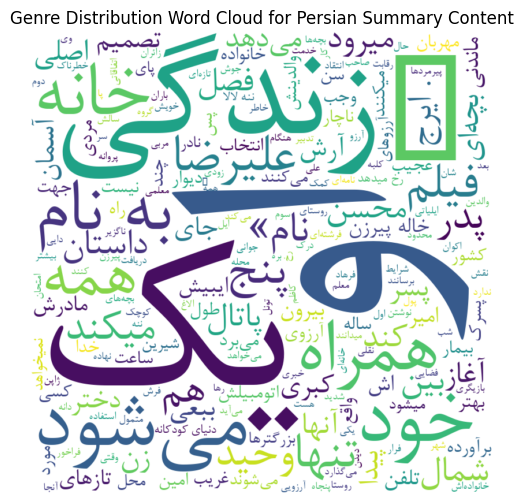

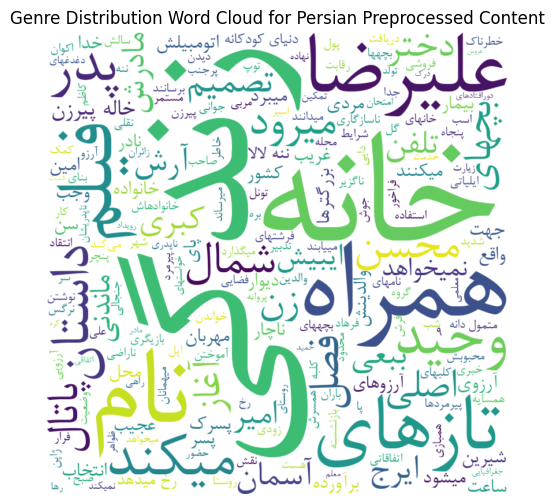

Romance


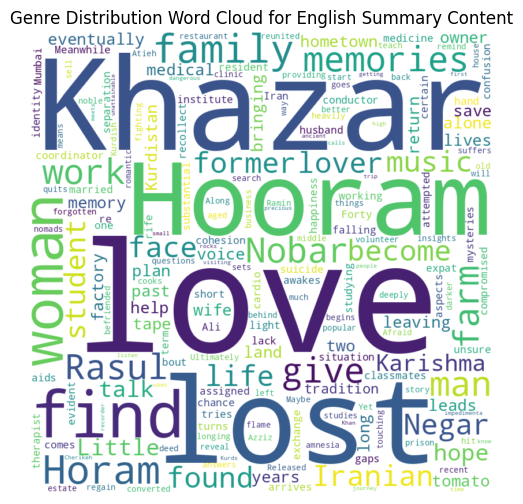

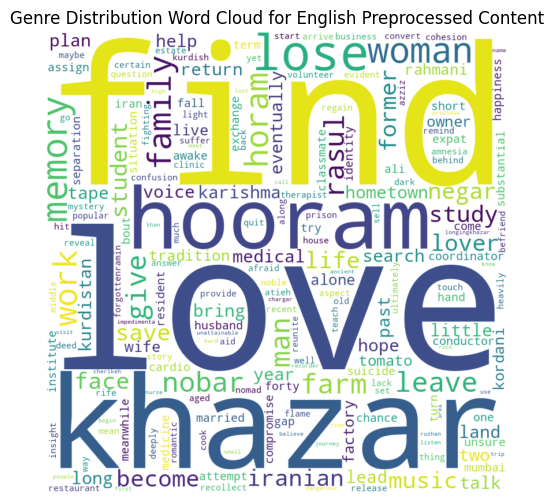

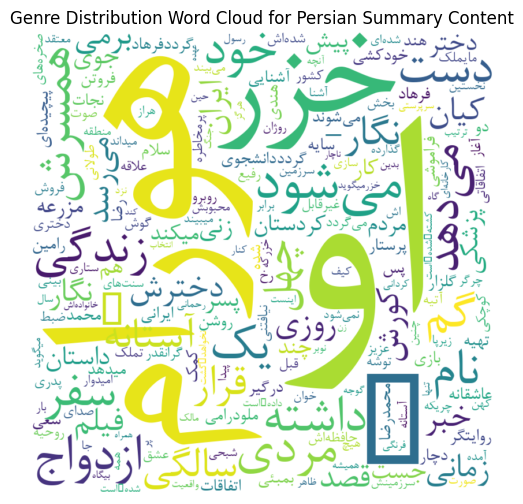

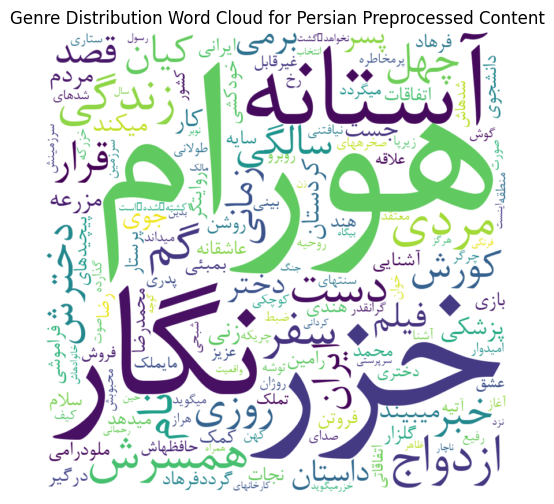

History


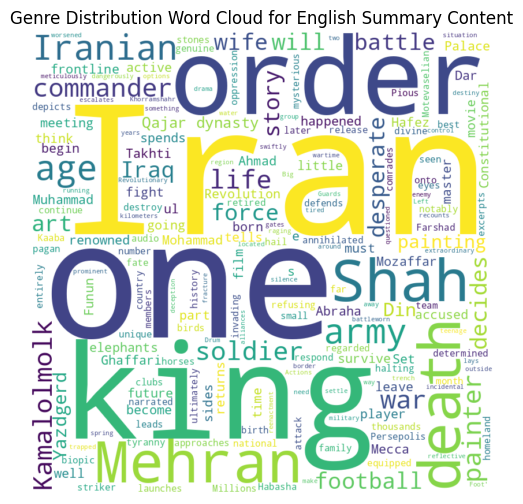

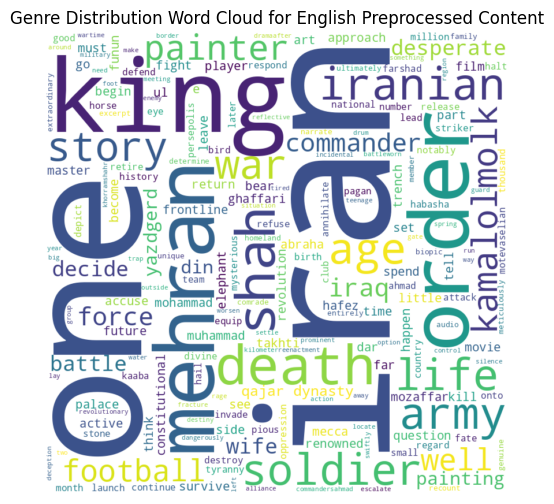

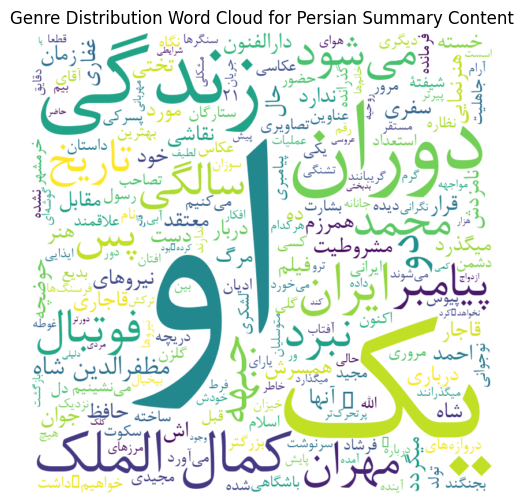

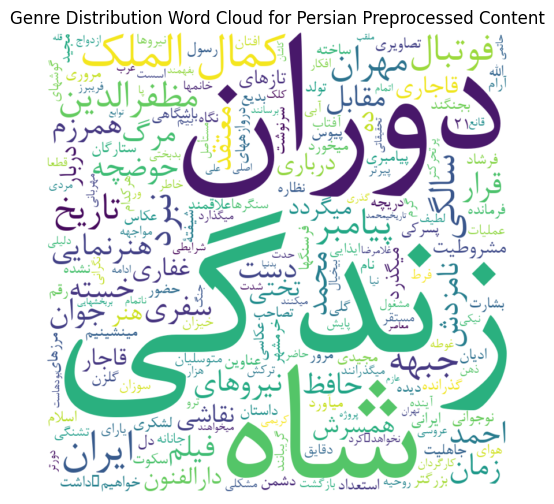

Animation


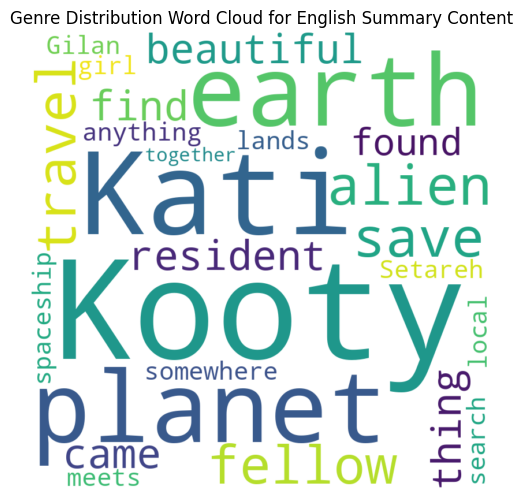

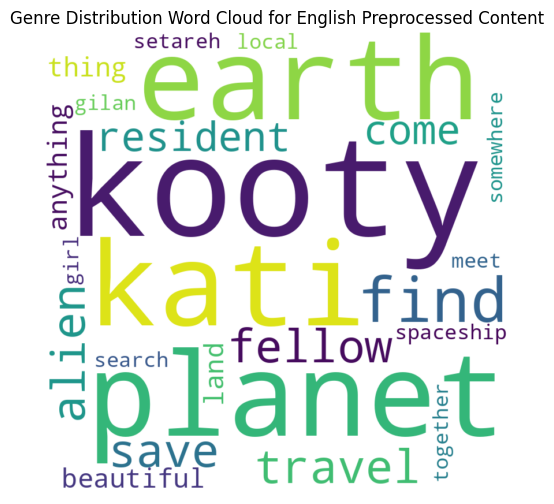

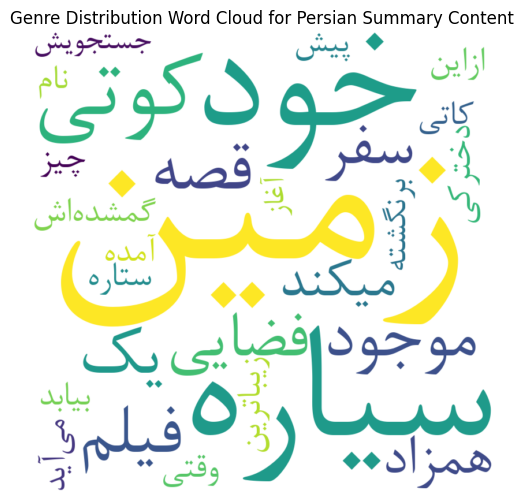

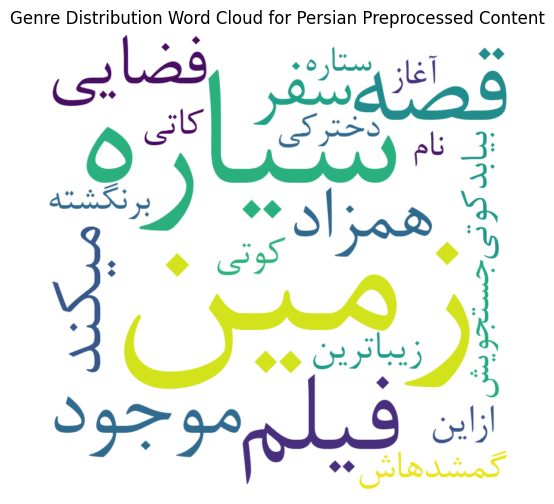

Arts & Literature


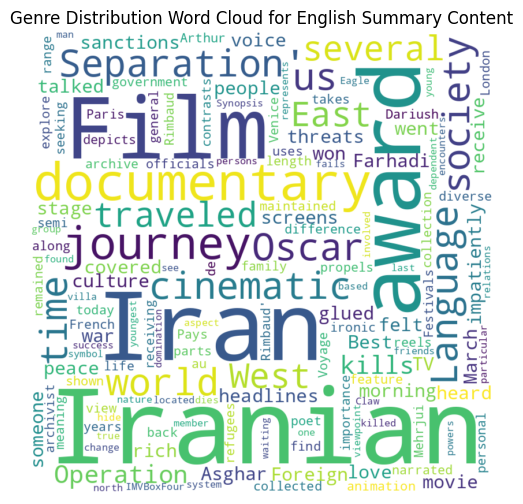

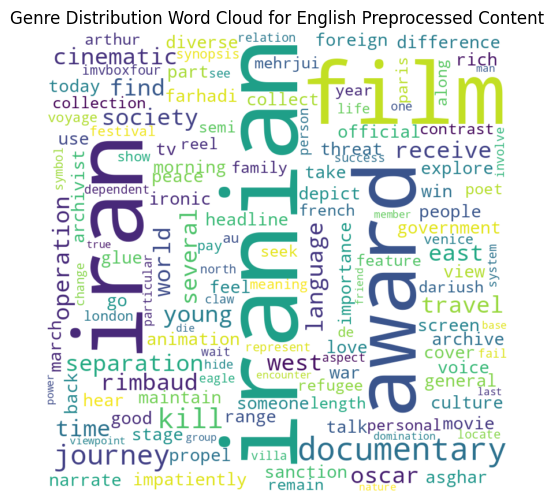

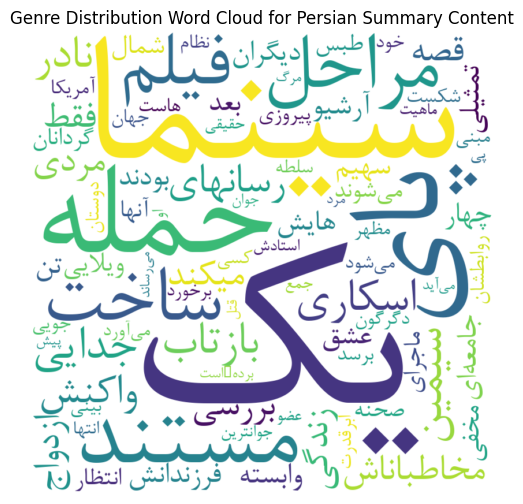

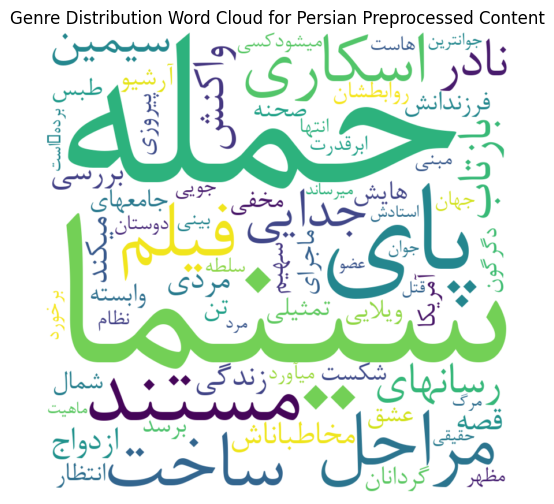

Horror


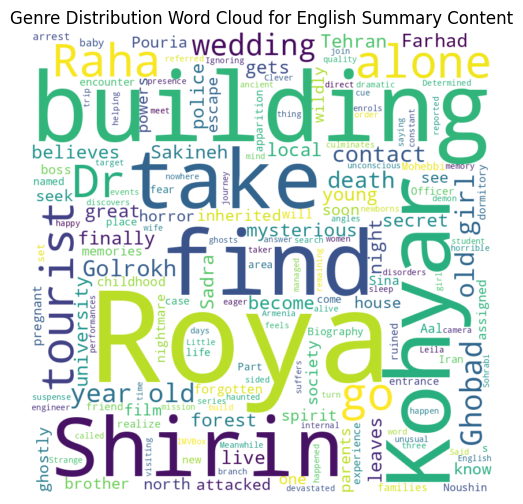

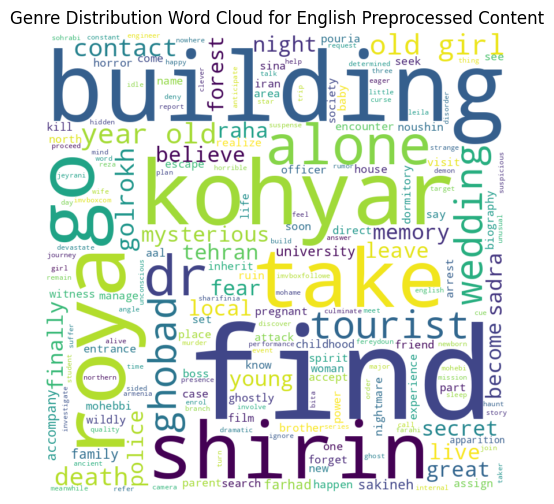

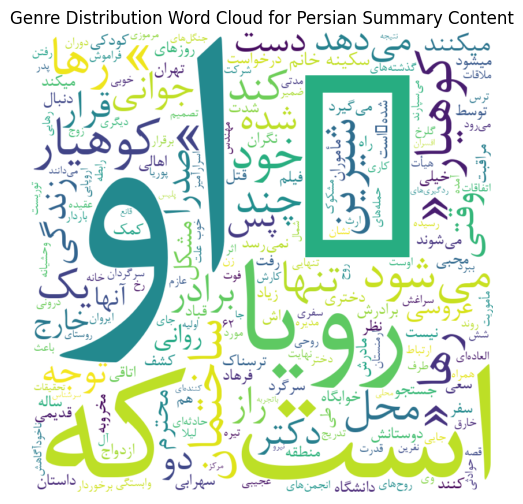

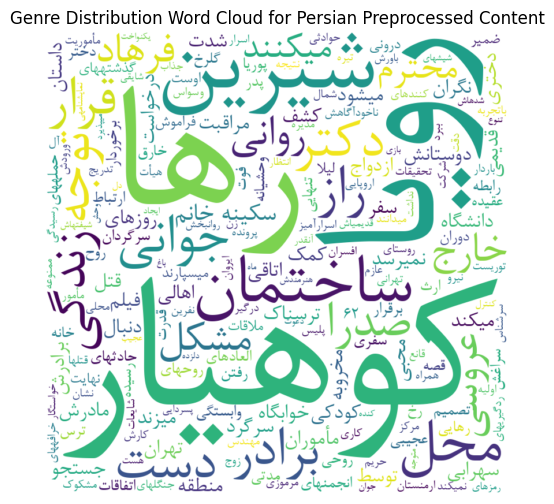

Thriller


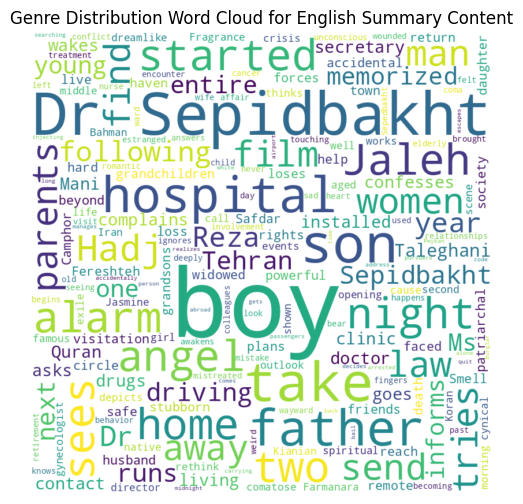

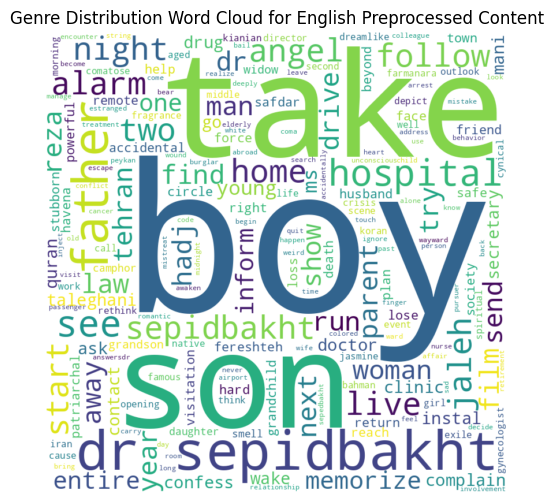

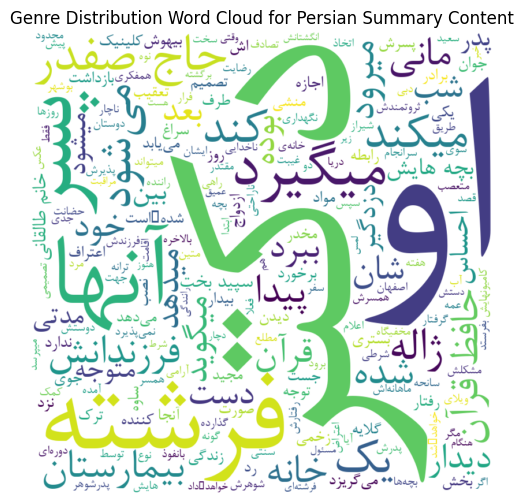

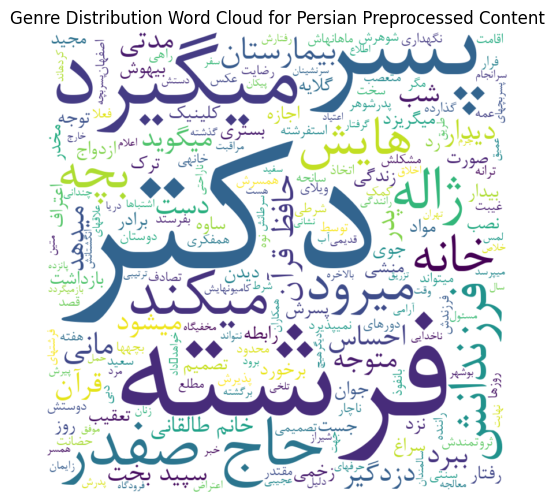

English Summary
Genre: Drama
1. word: the, count: 3024
2. word: to, count: 2370
3. word: and, count: 2200
4. word: a, count: 2061
5. word: of, count: 1703
6. word: is, count: 1391
7. word: his, count: 1205
8. word: in, count: 1055
9. word: her, count: 973
10. word: he, count: 634
Genre: Crime
1. word: the, count: 320
2. word: and, count: 228
3. word: to, count: 220
4. word: a, count: 217
5. word: of, count: 164
6. word: is, count: 138
7. word: his, count: 123
8. word: in, count: 108
9. word: he, count: 90
10. word: her, count: 81
Genre: Human Interest & Society
1. word: the, count: 54
2. word: and, count: 42
3. word: of, count: 38
4. word: to, count: 35
5. word: in, count: 22
6. word: a, count: 21
7. word: their, count: 17
8. word: is, count: 12
9. word: his, count: 9
10. word: have, count: 8
Genre: Comedy
1. word: the, count: 893
2. word: to, count: 785
3. word: and, count: 640
4. word: a, count: 564
5. word: of, count: 493
6. word: is, count: 384
7. word: his, count: 360
8. word: in,

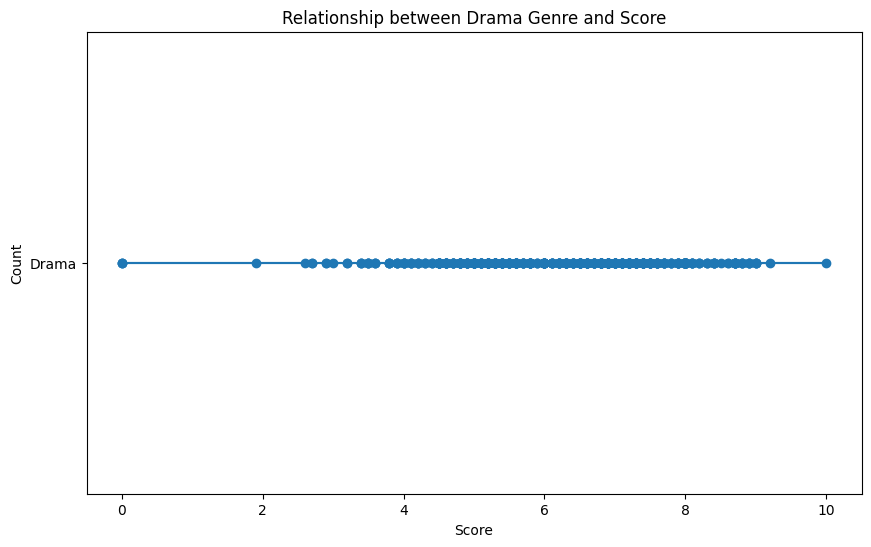

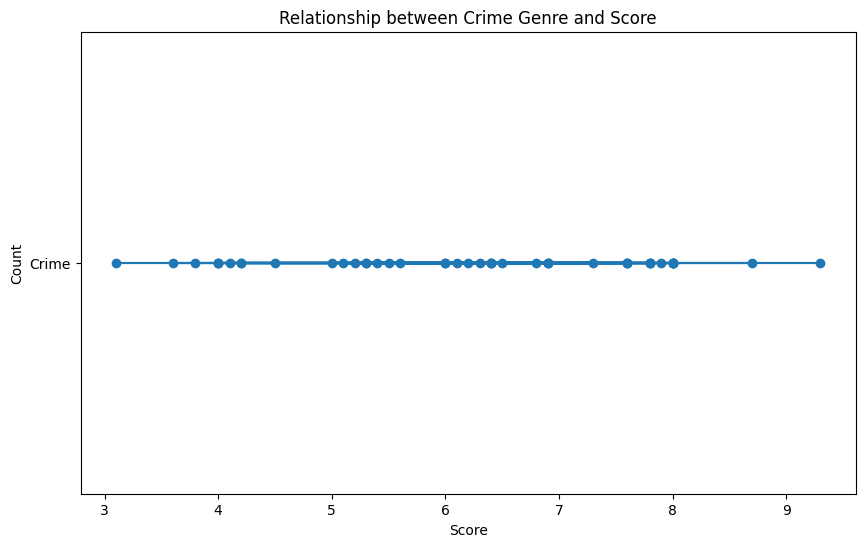

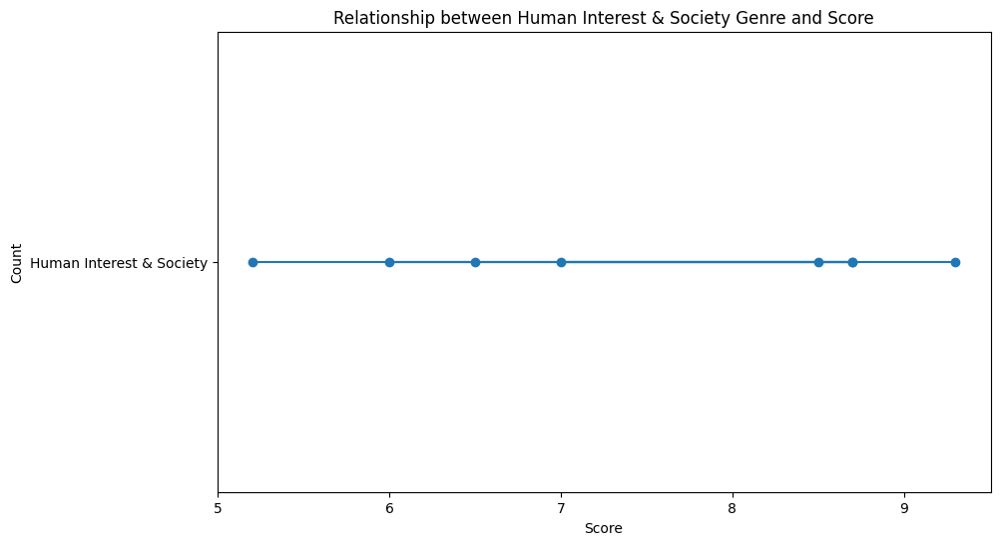

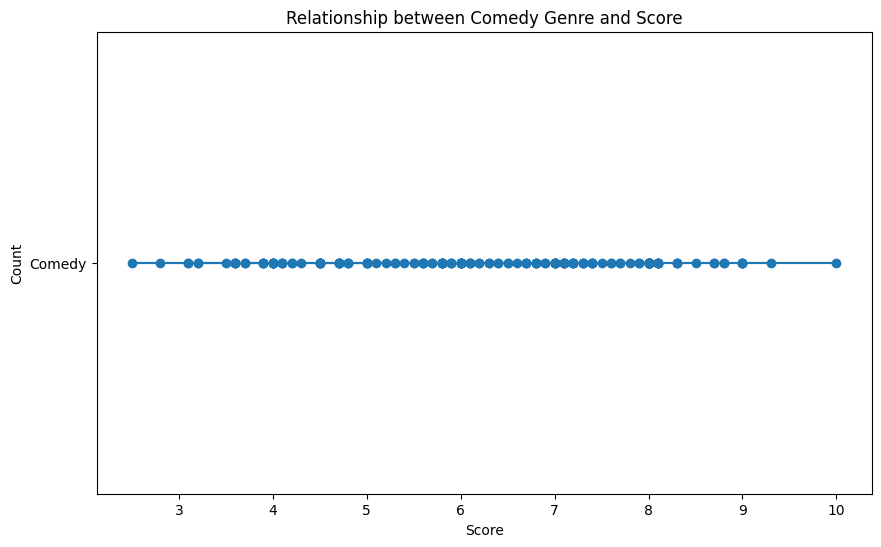

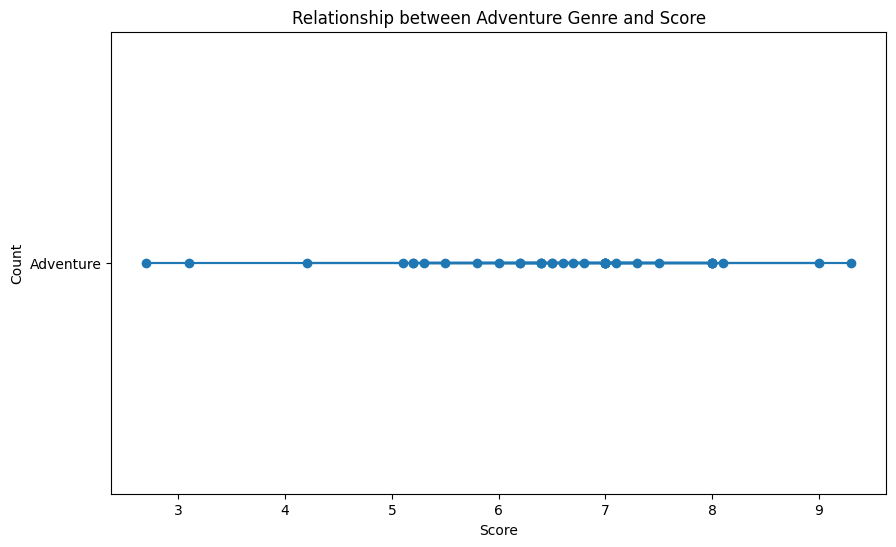

...

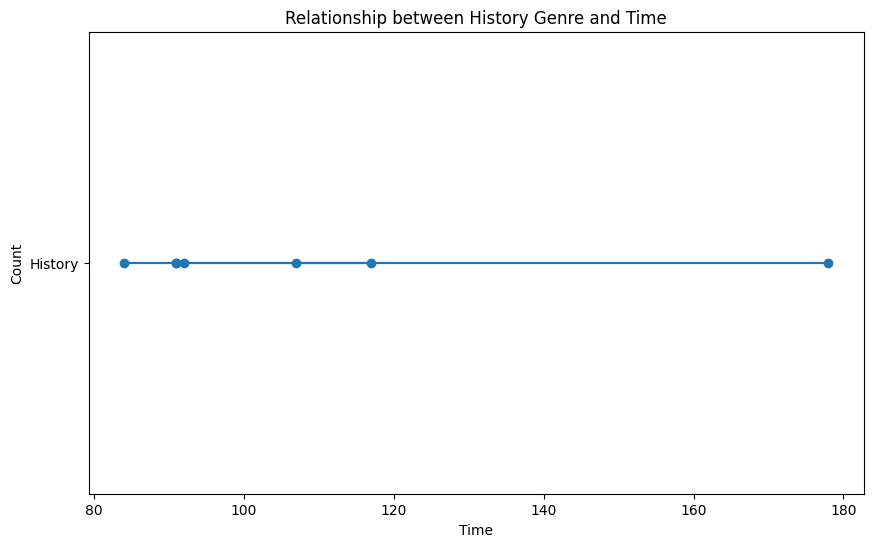

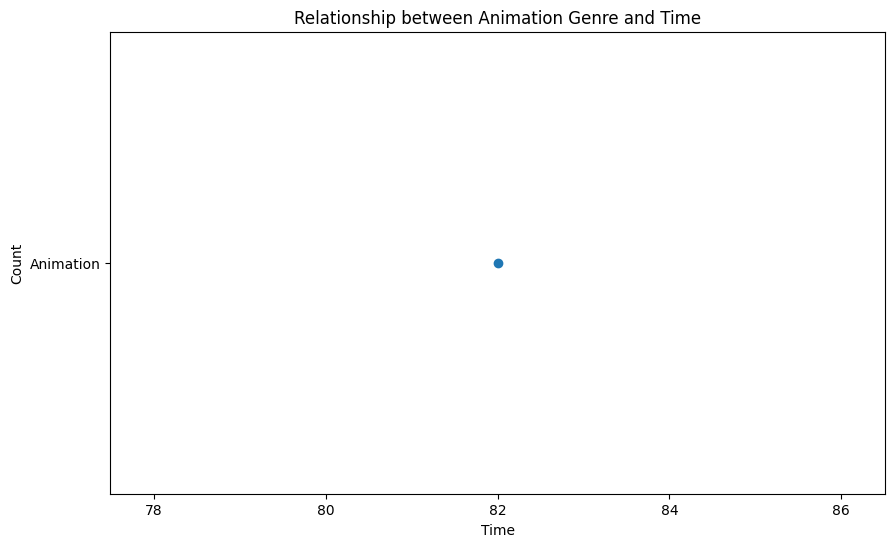

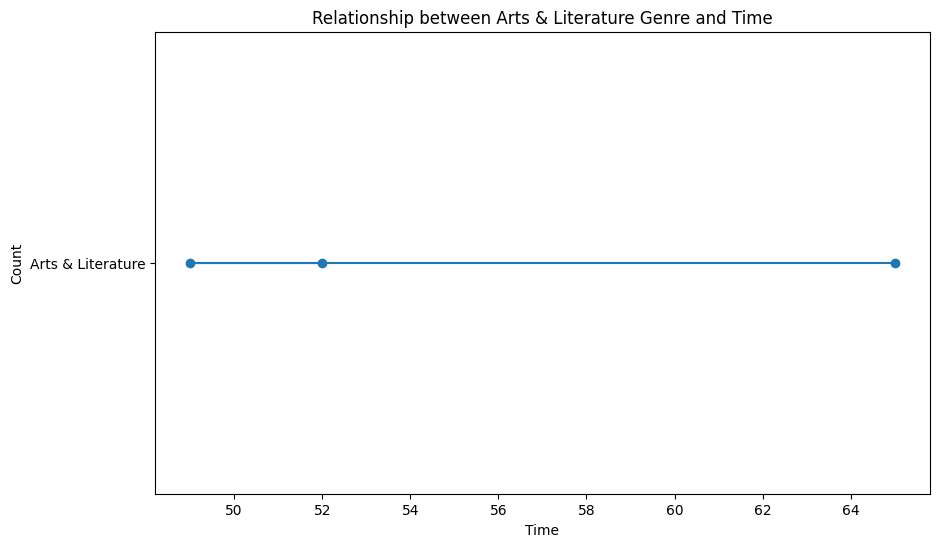

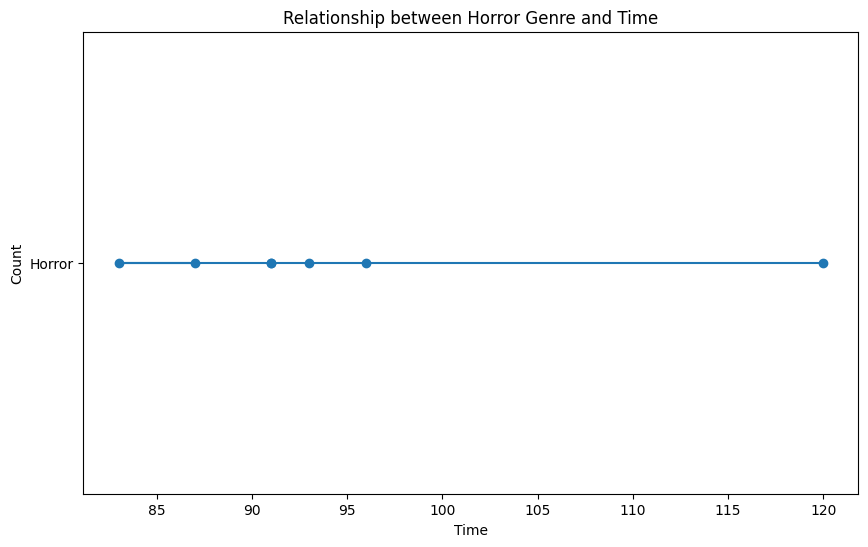

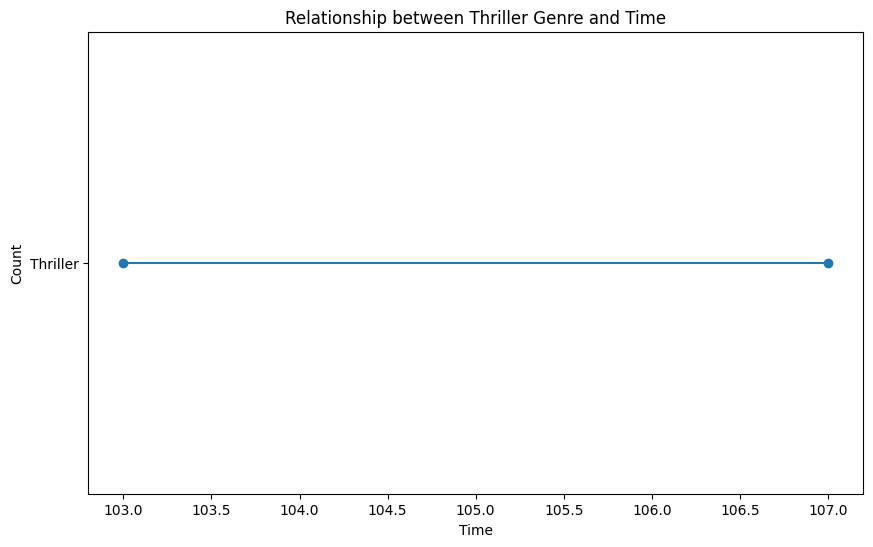

In [14]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud
from wordcloud_fa import WordCloudFa
from bidi import algorithm as bidi_algorithm

class GenreAnalysis:
    def __init__(self, df):
        self.df = df

    def process_text(self, text):
        words = text.split()
        reshaped_words = [bidi_algorithm.get_display(word) for word in words]
        return ' '.join(reshaped_words)

    def visualize_genre_distribution(self, column):
        """
        Create a word cloud or bar plot for genre distribution.

        Args:
            column (str): The column name containing the genre information.

        Returns:
            None (displays the plot)

        TODO:
        1. Check if the data is in Persian or English.
        2. If the data is in Persian, use the bidi library to handle right-to-left text direction.
        3. Create a word cloud or bar plot for the genre distribution using Matplotlib or Seaborn.
        4. Set appropriate titles and labels for the plot.
        5. Display the plot.
        """
        for genre in self.df[column].unique():
          print(genre)
          new_df = df[df[column] == genre]
          content_1_text = ' '.join(new_df['Persian Summary'])
          content_2_text = ' '.join(new_df['English Summary'])
          preprocessed_English_text = ' '.join(new_df['Preprocessed English'])
          preprocessed_Persian_text = ' '.join(new_df['Preprocessed Persian'])

          persian_texts = [content_1_text, preprocessed_Persian_text]
          english_texts = [content_2_text, preprocessed_English_text]
          i = 0
          for text in english_texts:

            wordcloud = WordCloud(width=800, height=800, background_color='white', min_font_size=10).generate(text)

            plt.figure(figsize=(10, 6))
            plt.imshow(wordcloud, interpolation='bilinear')
            plt.axis('off')
            if i == 0:
              plt.title('Genre Distribution Word Cloud for English Summary Content')
            else:
              plt.title('Genre Distribution Word Cloud for English Preprocessed Content')
            plt.show()
            i += 1
          i = 0
          for text in persian_texts:
            text = bidi_algorithm.get_display(text)

            # Encode the text to utf-8
            text = text.encode().decode('utf-8')

            text = text[::-1]
            wordcloud = WordCloudFa(persian_normalize=True, width=800, height=800, background_color='white',
                                    min_font_size=10, font_path="B-NAZANIN.TTF", no_reshape=True).generate(text)
            plt.figure(figsize=(10, 6))
            plt.imshow(wordcloud, interpolation='bilinear')
            plt.axis('off')
            if i == 0:
              plt.title('Genre Distribution Word Cloud for Persian Summary Content')
            else:
              plt.title('Genre Distribution Word Cloud for Persian Preprocessed Content')
            plt.show()
            i += 1

    def frequent_words_by_genre(self, content_column, genre_column):
        """
        Obtain the 10 most frequently occurring words for each genre, based on both the initial summaries and the preprocessed summaries.

        Args:
            content_column (str): The column name containing the text data.
            genre_column (str): The column name containing the genre information.

        Returns:
            None (prints the top 10 most frequent words for each genre)

        TODO:
        1. Group the data by genre.
        2. For each genre:
            a. Get the top 10 most frequent words from the initial summaries.
            b. Get the top 10 most frequent words from the preprocessed summaries (if available).
            c. Print the top 10 frequent words for both cases.
        """
        print(content_column)
        for genre in self.df[genre_column].unique():
            new_df = self.df[self.df[genre_column] == genre]
            text = ' '.join(new_df[content_column]).split()
            word_frequencies = Counter(text).most_common(10)
            print(f"Genre: {genre}")
            i = 1
            for word, num in word_frequencies:
              print(f'{i}. word: {word}, count: {num}')
              i += 1


    def analyze_genre_distribution(self, genre_column):
        """
        Analyze the distribution of movies across genres.

        Args:
            genre_column (str): The column name containing the genre information.

        Returns:
            None (prints the analysis of genre distribution)

        TODO:
        1. Calculate the count of movies for each genre.
        2. Determine the most and least popular genres based on the movie count.
        3. Print the analysis of genre distribution, including the most and least popular genres.
        """
        grouped_data = self.df.groupby(genre_column)
        genre_counts = grouped_data.size()
        most_popular_genre = genre_counts.idxmax()
        least_popular_genre = genre_counts.idxmin()
        print(f"Most popular genre: {most_popular_genre} ({genre_counts[most_popular_genre]} movies)")
        print(f"Least popular genre: {least_popular_genre} ({genre_counts[least_popular_genre]} movies)")

    def explore_genre_relationships(self, genre_column, other_columns):
        """
        Explore the relationship between genres and other variables.

        Args:
            genre_column (str): The column name containing the genre information.
            other_columns (list): A list of column names to explore relationships with.

        Returns:
            None (displays plots or prints analysis)

        TODO:
        1. Iterate through each column in other_columns.
        2. Generate appropriate plots or calculations to explore the relationship between genres and the selected column.
        3. Set appropriate titles and labels for the plots.
        4. Display the plots or print the analysis.
        """
        for column in other_columns:
          for genre in self.df[genre_column].unique():
              genre_data = self.df[self.df[genre_column] == genre]
              plt.figure(figsize=(10, 6))
              plt.title(f'Relationship between {genre} Genre and {column}')
              plt.xlabel(column)
              plt.ylabel('Count')
              if self.df[column].dtype == 'category':
                  genre_data[column].value_counts().plot(kind='bar')
              else:
                  plt.scatter(genre_data[column], genre_data[genre_column])
                  plt.plot(genre_data[column], genre_data[genre_column])
              plt.show()


genre_analysis = GenreAnalysis(df)
genre_column = 'Genre'
other_columns = ['Score', 'Year', 'Time']

# TODO: Call the visualize_genre_distribution method with the genre_column
genre_analysis.visualize_genre_distribution(genre_column)

# TODO: Call the frequent_words_by_genre method with the content_column and genre_column
content_columns = ['English Summary', 'Preprocessed English', 'Persian Summary', 'Preprocessed Persian']
for content_column in content_columns:
  genre_analysis.frequent_words_by_genre(content_column, genre_column)

# # TODO: Call the analyze_genre_distribution method with the genre_column
genre_analysis.analyze_genre_distribution(genre_column)

# # TODO: Call the explore_genre_relationships method with the genre_column and other_columns
genre_analysis.explore_genre_relationships(genre_column, other_columns)

In one paragraph, briefly explain what you found interesting in your analysis and whether this analysis prompted you to take any further steps; if so, explain those additional steps.



###5. **Time-based Analysis**:
   - Plot line or bar charts for movie releases over time
   - Investigate trends or patterns in movie releases
   - Analyze the relationship between release year and other variables

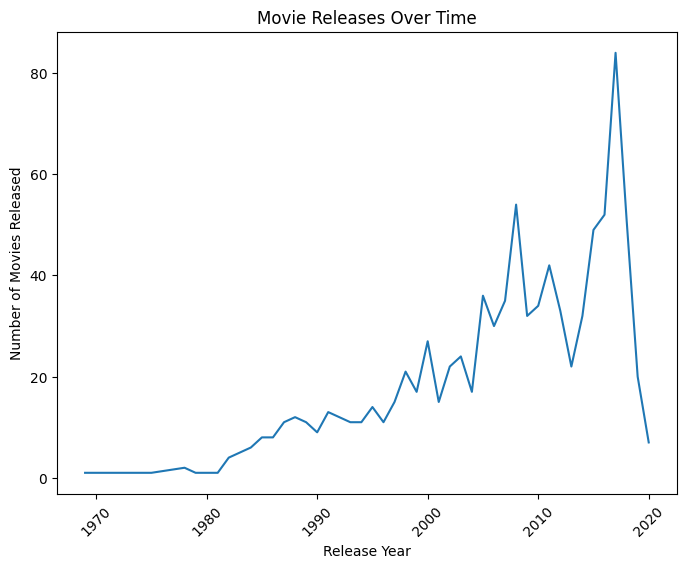

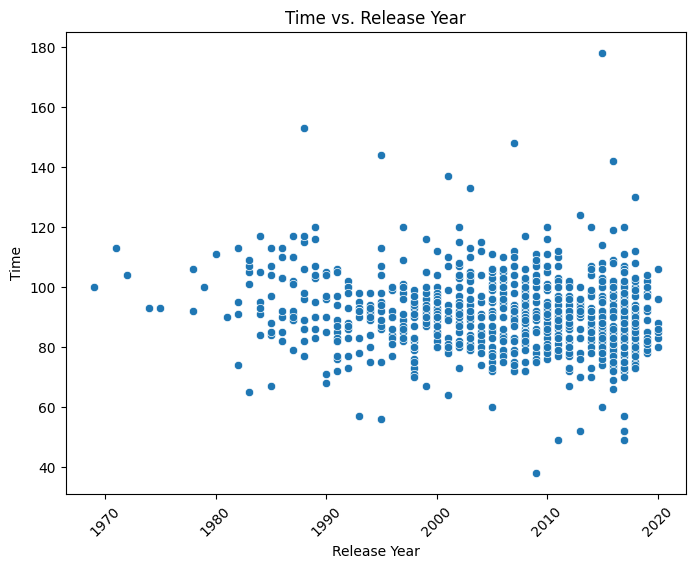

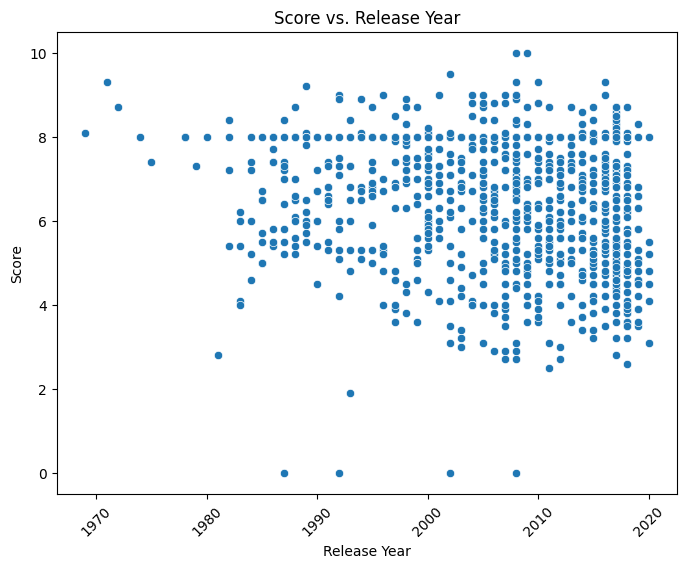

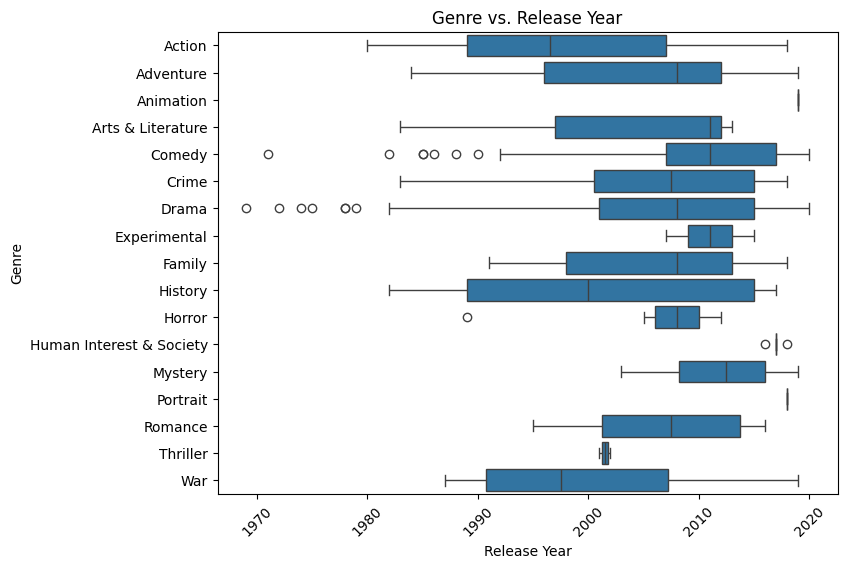

In [15]:
import matplotlib.pyplot as plt
import seaborn as sns

class TimeAnalysis:
    def __init__(self, df):
        self.df = df

    def plot_movie_releases(self, time_column):
        """
        Plot line or bar charts for movie releases over time.

        Args:
            time_column (str): The column name containing the time or release year information.

        Returns:
            None (displays the plot)

        TODO:
        1. Check if the time_column contains continuous time data (e.g., years) or discrete time data (e.g., decades).
        2. Create a line or bar chart to show the distribution of movie releases over time using Matplotlib or Seaborn.
        3. Set appropriate titles and labels for the plot.
        4. Display the plot.
        """
        unique_values = self.df[time_column].unique()

        if len(unique_values) > 20:
            data = self.df.groupby(time_column).size().reset_index(name='MovieCount')
            plt.figure(figsize=(8, 6))
            sns.lineplot(x=time_column, y="MovieCount", data=data)
        else:
            data = self.df[time_column].value_counts().reset_index()
            data.columns = [time_column, 'MovieCount']
            data = data.sort_values(by=time_column)
            plt.figure(figsize=(8, 6))
            sns.barplot(x=time_column, y="MovieCount", data=data)

        plt.title("Movie Releases Over Time")
        plt.xlabel("Release " + time_column)
        plt.ylabel("Number of Movies Released")
        plt.xticks(rotation=45)
        plt.show()

    def explore_time_relationships(self, time_column, other_columns):
        """
        Analyze the relationship between release time and other variables.

        Args:
            time_column (str): The column name containing the time or release year information.
            other_columns (list): A list of column names to explore relationships with.

        Returns:
            None (displays plots or prints analysis)

        TODO:
        1. Iterate through each column in other_columns.
        2. Generate appropriate plots or calculations to explore the relationship between release time and the selected column.
        3. Set appropriate titles and labels for the plots.
        4. Display the plots or print the analysis.
        """
        for col in other_columns:
            plt.figure(figsize=(8, 6))

            if pd.api.types.is_numeric_dtype(self.df[col]):
                sns.scatterplot(x=time_column, y=col, data=self.df)
            else:
                sns.boxplot(x=time_column, y=col, data=self.df)

            plt.title(f"{col} vs. Release " + time_column)
            plt.xlabel("Release " + time_column)
            plt.ylabel(col)
            plt.xticks(rotation=45)
            plt.show()

time_column = 'Year'
other_columns = ['Time', 'Score', 'Genre']

# Assuming you have a pandas DataFrame named 'df'
time_analysis = TimeAnalysis(df)

# TODO: Call the plot_movie_releases method with the time_column
time_analysis.plot_movie_releases(time_column)

# TODO: Call the explore_time_relationships method with the time_column and other_columns
time_analysis.explore_time_relationships(time_column, other_columns)

In one paragraph, briefly explain what you found interesting in your analysis.



###6. **Rating Analysis**:
   - Visualize the distribution of ratings
   - Obtain the 10 most frequently occurring words for each Rating, based on both the initial summaries and the preprocessed summaries.
   - Explore the relationship between ratings and other variables


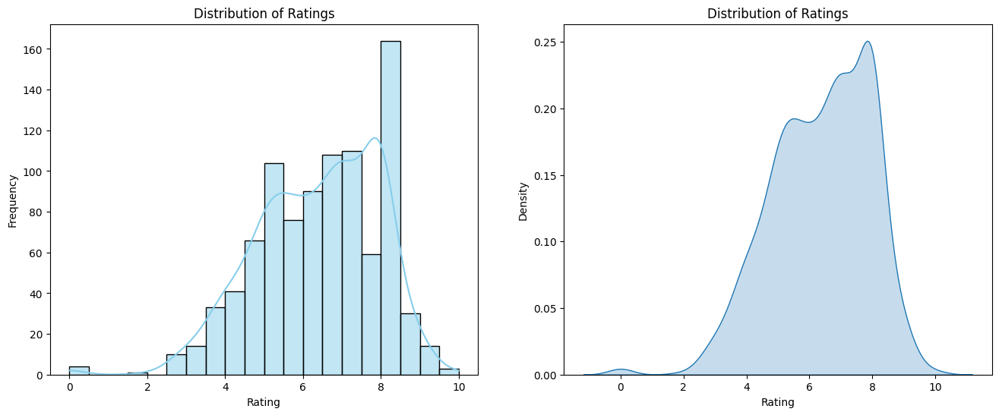

--------------------------------------------------
Rating: 0.0
most frequent words in Persian Summary column:
  و: 33
  به: 26
  می: 22
  از: 18
  که: 18
  را: 17
  در: 15
  با: 14
  ناهید: 12
  او: 10
--------------------------------------------------
Rating: 1.9
most frequent words in Persian Summary column:
  چکمه: 2
  که: 2
  دخترکی: 1
  فکر: 1
  می: 1
  کند: 1
  هایی: 1
  تازه: 1
  خریده: 1
  است: 1
--------------------------------------------------
Rating: 2.5
most frequent words in Persian Summary column:
  و: 6
  در: 5
  می: 4
  بیمارستان: 3
  به: 2
  شهر: 2
  هر: 2
  یک: 2
  برنامه: 2
  تا: 2
--------------------------------------------------
Rating: 2.6
most frequent words in Persian Summary column:
  می: 3
  دختر: 2
  شیطان: 2
  .: 2
  آدم: 2
  زمین: 2
  داستان: 1
  یکی: 1
  از: 1
  بچه: 1
--------------------------------------------------
Rating: 2.7
most frequent words in Persian Summary column:
  در: 6
  می: 6
  و: 5
  را: 5
  که: 4
  آن: 4
  از: 3
  او: 3
  جوان: 3
  است

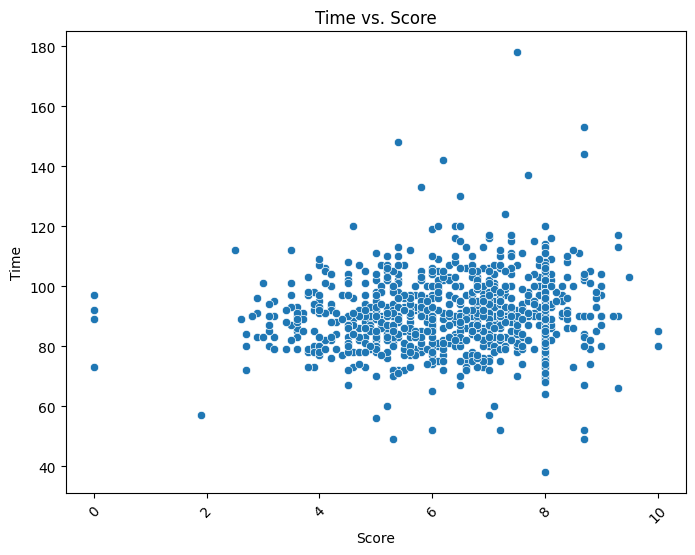

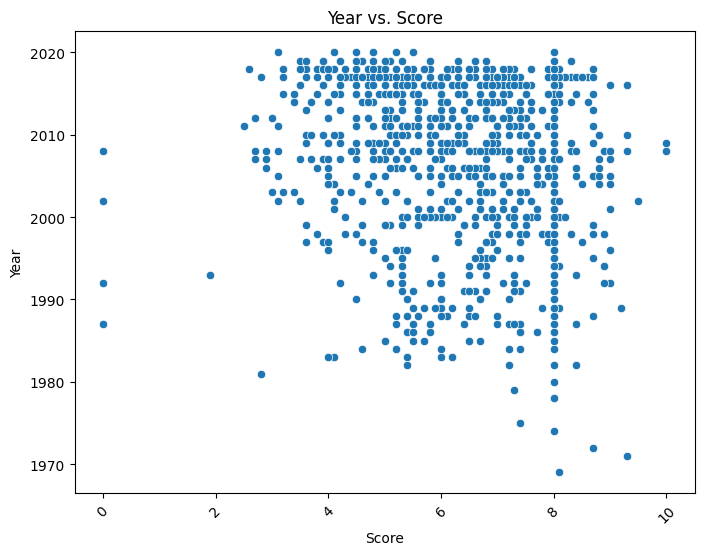

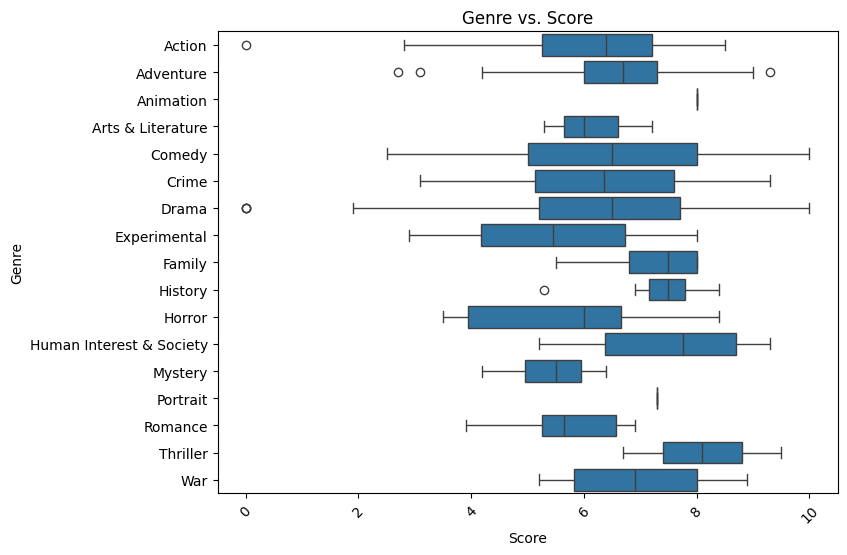

In [16]:
import matplotlib.pyplot as plt
from collections import Counter

class RatingAnalysis:
    def __init__(self, df):
        self.df = df

    def visualize_rating_distribution(self, rating_column):
        """
        Visualize the distribution of ratings.

        Args:
            rating_column (str): The column name containing the rating information.

        Returns:
            None (displays the plot)

        TODO:
        1. Create a histogram or density plot to visualize the distribution of ratings using Matplotlib or Seaborn.
        2. Set appropriate titles and labels for the plot.
        3. Display the plot.
        """
        plt.figure(figsize=(16, 6))

        plt.subplot(1, 2, 1)
        sns.histplot(self.df[rating_column], kde=True, bins=20, color='skyblue')
        plt.title("Distribution of Ratings")
        plt.xlabel("Rating")
        plt.ylabel("Frequency")

        plt.subplot(1, 2, 2)
        sns.kdeplot(self.df[rating_column], shade=True)
        plt.title('Distribution of Ratings')
        plt.xlabel('Rating')
        plt.ylabel('Density')
        plt.show()

    def frequent_words_by_rating(self, content_column, rating_column, n=10):
        """
        Obtain the 10 most frequently occurring words for each rating, based on both the initial summaries and the preprocessed summaries.

        Args:
            content_column (str): The column name containing the text data.
            rating_column (str): The column name containing the rating information.
            n (int): The number of most frequent words to obtain (default is 10).

        Returns:
            None (prints the top n frequent words for each rating)

        TODO:
        1. Group the data by rating.
        2. For each rating:
            a. Get the top n most frequent words from the initial summaries.
            b. Get the top n most frequent words from the preprocessed summaries (if available).
            c. Print the top n frequent words for both cases.
        """
        print("-" * 50)

        grouped = self.df.groupby(rating_column)

        for rating, group in grouped:
            initial_text = ' '.join(group[content_column])
            initial_word_counts = Counter(initial_text.split())
            initial_most_common = initial_word_counts.most_common(n)

            print(f"Rating: {rating}")
            print("most frequent words in " + content_column + " column:")
            for word, count in initial_most_common:
                print(f"  {word}: {count}")
            print("-" * 50)

    def explore_rating_relationships(self, rating_column, other_columns):
        """
        Explore the relationship between ratings and other variables.

        Args:
            rating_column (str): The column name containing the rating information.
            other_columns (list): A list of column names to explore relationships with.

        Returns:
            None (displays plots or prints analysis)

        TODO:
        1. Iterate through each column in other_columns.
        2. Generate appropriate plots or calculations to explore the relationship between ratings and the selected column.
        3. Set appropriate titles and labels for the plots.
        4. Display the plots or print the analysis.
        """
        for col in other_columns:
            plt.figure(figsize=(8, 6))

            if pd.api.types.is_numeric_dtype(self.df[col]):
                sns.scatterplot(x=rating_column, y=col, data=self.df)
            else:
                sns.boxplot(x=rating_column, y=col, data=self.df)

            plt.title(f"{col} vs. " + rating_column)
            plt.xlabel(rating_column)
            plt.ylabel(col)
            plt.xticks(rotation=45)
            plt.show()

rating_analysis = RatingAnalysis(df)
rating_column = 'Score'
other_columns = ['Time', 'Year', 'Genre']
initial_persion_summary = 'Persian Summary'
initial_english_summary = 'English Summary'
preprocessed_persion_summary = 'Preprocessed Persian'
preprocessed_english_summary = 'Preprocessed English'

# TODO: Call the visualize_rating_distribution method with the rating_column
rating_analysis.visualize_rating_distribution(rating_column)

# TODO: Call the frequent_words_by_rating method with the content_column and rating_column
rating_analysis.frequent_words_by_rating(initial_persion_summary, rating_column)
rating_analysis.frequent_words_by_rating(initial_english_summary, rating_column)
rating_analysis.frequent_words_by_rating(preprocessed_persion_summary, rating_column)
rating_analysis.frequent_words_by_rating(preprocessed_english_summary, rating_column)

# TODO: Call the explore_rating_relationships method with the rating_column and other_columns
rating_analysis.explore_rating_relationships(rating_column, other_columns)

In one paragraph, briefly explain what you found interesting in your analysis.


###7. **Correlation and Multivariate Analysis**:
   - Calculate correlation coefficients between numerical variables
   - Use scatter plot matrices or pair plots for multivariate visualization
   - Employ dimensionality reduction techniques (e.g., PCA) for better visualization

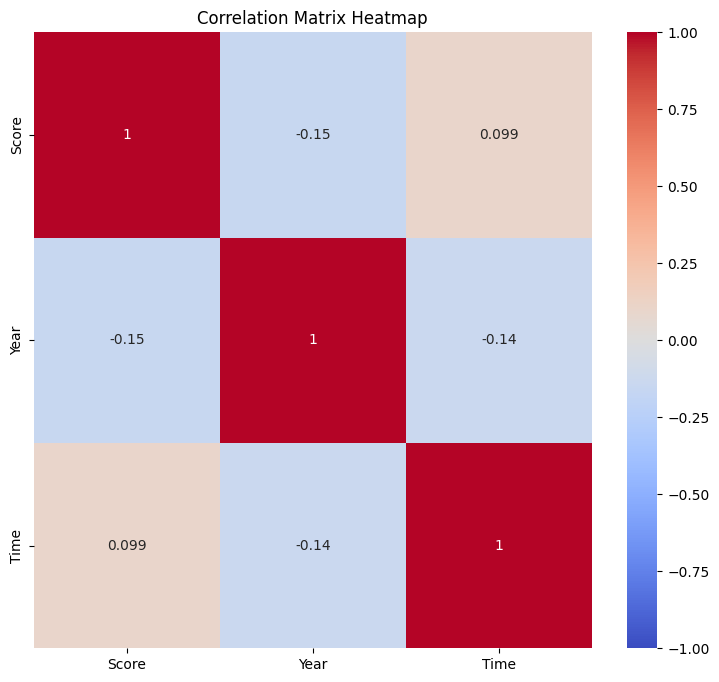

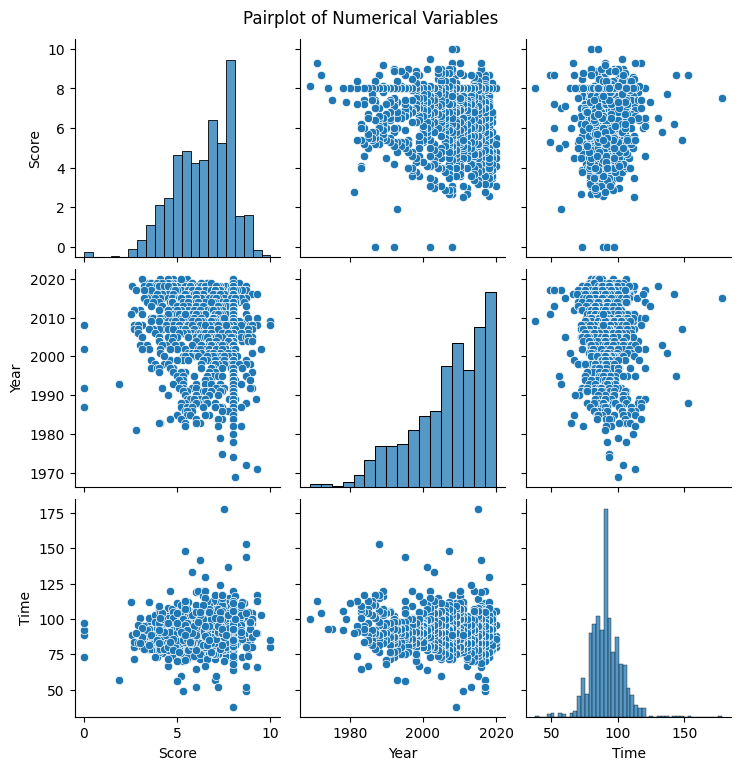

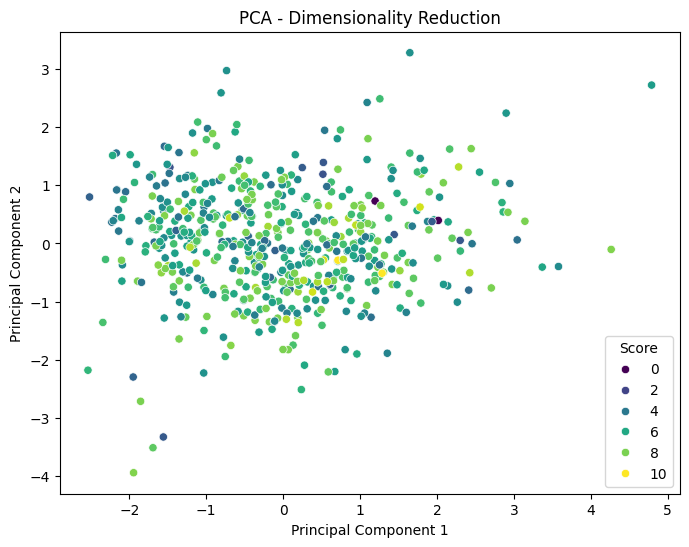

In [17]:
# Feel free to add any desired methods to the class below this is a suggestion.
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

class MultivariateAnalysis:
    def __init__(self, df):
        self.df = df

    def calculate_correlations(self, numerical_cols):
        """
        Calculate correlation coefficients between numerical variables.

        Args:
            numerical_cols (list): A list of column names containing numerical data.

        Returns:
            None (prints the correlation matrix)

        TODO:
        1. Select the numerical columns from the DataFrame.
        2. Calculate the correlation matrix between the numerical columns.
        3. Print the correlation matrix.
        """
        correlation_matrix = self.df[numerical_cols].corr()

        plt.figure(figsize=(9, 8))
        sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
        plt.title("Correlation Matrix Heatmap")
        plt.show()

    def visualize_multivariate(self, numerical_cols):
        """
        Use scatter plot matrices or pair plots for multivariate visualization.

        Args:
            numerical_cols (list): A list of column names containing numerical data.

        Returns:
            None (displays the multivariate plot)

        TODO:
        1. Select the numerical columns from the DataFrame.
        2. Create a scatter plot matrix or pair plot using Matplotlib or Seaborn for multivariate visualization.
        3. Set appropriate titles and labels for the plot.
        4. Display the plot.
        """
        sns.pairplot(self.df[numerical_cols])
        plt.suptitle("Pairplot of Numerical Variables", y=1.02)
        plt.show()

    def dimensionality_reduction(self, numerical_cols, target_column=None):
        """
        Employ dimensionality reduction techniques (e.g., PCA) for better visualization.

        Args:
            numerical_cols (list): A list of column names containing numerical data.
            target_column (str, optional): The column name containing the target variable (if applicable).

        Returns:
            None (displays the dimensionality-reduced plot)

        TODO:
        1. Select the numerical columns from the DataFrame.
        2. Perform standardization on the numerical data.
        3. Apply Principal Component Analysis (PCA) or another dimensionality reduction technique.
        4. If a target_column is provided, color the data points based on the target variable.
        5. Create a scatter plot for the first two principal components.
        6. Set appropriate titles and labels for the plot.
        7. Display the plot.
        """
        x = self.df[numerical_cols].values
        x = StandardScaler().fit_transform(x)

        pca = PCA(n_components=2)
        principal_components = pca.fit_transform(x)
        principal_df = pd.DataFrame(data=principal_components, columns=['Principal Component 1', 'Principal Component 2'])

        if target_column:
            final_df = pd.concat([principal_df, self.df[[target_column]]], axis=1)
        else:
            final_df = principal_df

        plt.figure(figsize=(8, 6))
        if target_column:
            sns.scatterplot(data=final_df, x='Principal Component 1', y='Principal Component 2', hue=target_column, palette='viridis')
        else:
            plt.scatter(final_df['Principal Component 1'], final_df['Principal Component 2'])

        plt.title('PCA - Dimensionality Reduction')
        plt.xlabel('Principal Component 1')
        plt.ylabel('Principal Component 2')
        plt.show()

# Example usage
numerical_cols = df.select_dtypes(include=['number']).columns.tolist()
target_column = 'Score' # This is a suggestion feel free to try other targets as well.

# Assuming you have a pandas DataFrame named 'df'
multivariate_analysis = MultivariateAnalysis(df)

# TODO: Call the calculate_correlations method with the numerical_cols list
multivariate_analysis.calculate_correlations(numerical_cols)

# TODO: Call the visualize_multivariate method with the numerical_cols list
multivariate_analysis.visualize_multivariate(numerical_cols)

# TODO: Call the dimensionality_reduction method with the numerical_cols list and target_column
multivariate_analysis.dimensionality_reduction(numerical_cols, target_column)

In one paragraph, briefly explain what you found interesting in your analysis.


###8. **Outlier Detection**:
   - Identify and investigate potential outliers
   - Determine if outliers are genuine or result from data issues

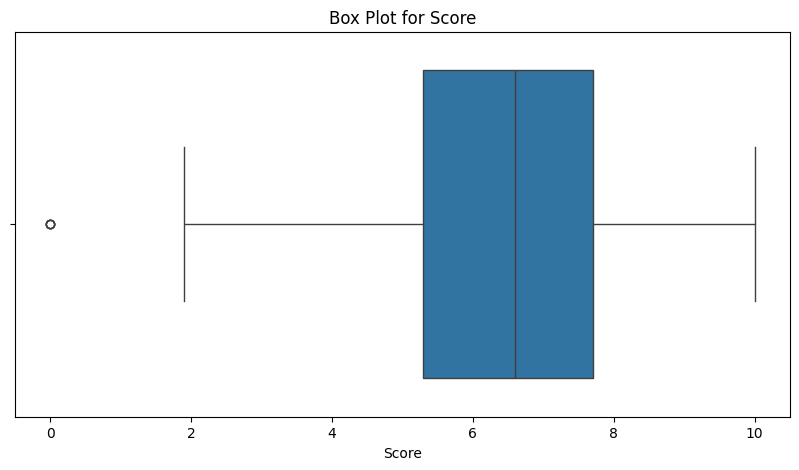

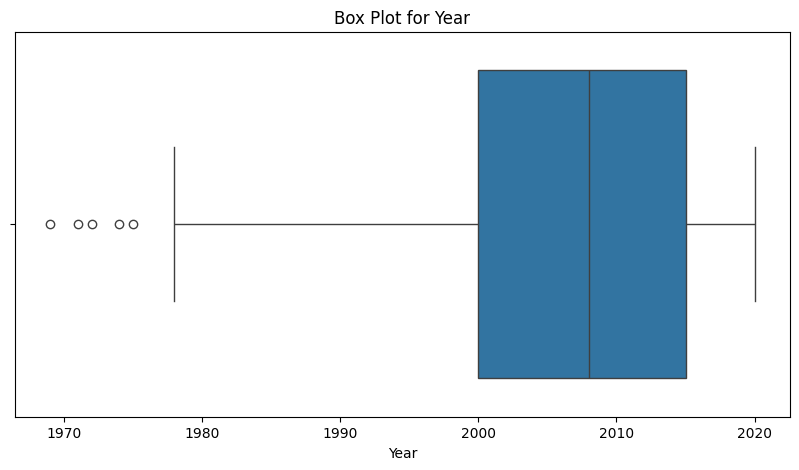

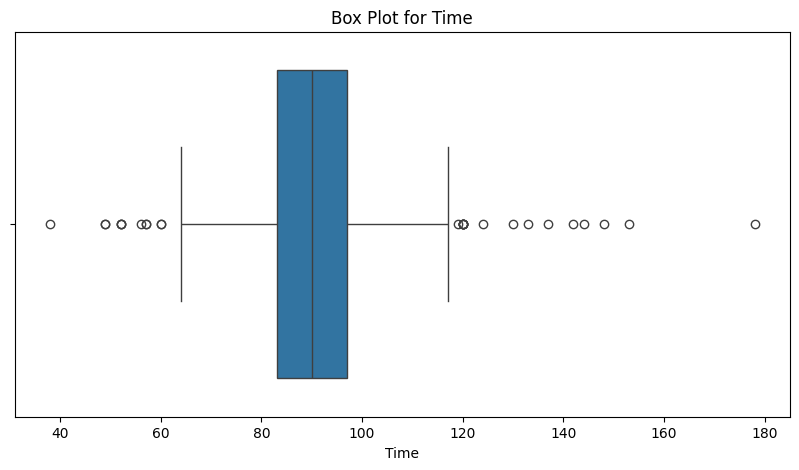

Analysis for Score:
IQR method detected 4 outliers.
Z-score method detected 4 outliers.
IQR Outliers:


,Link,EN_title,PENGLISH_title,PERSIAN_title,Persian Summary,English Summary,Score,Year,Genre,Time,Preprocessed English,Preprocessed Persian
177,https://www.imvbox.com/watch-persian-movie-ira...,Autumn,Payizan,پاییزان,مسعود قصد خروج از کشور و ترک پروانه و فرزندش ر...,Masoud wants to leave his wife Parvaneh and th...,0.0,1987,Drama,89,masoud want leave wife parvaneh daughter go eu...,مسعود قصد خروج کشور ترک پروانه فرزندش مسعود پر...
831,https://www.imvbox.com/watch-persian-movie-ira...,Shoot the Target,Be Hadaf Shelik Kon,به هدف شلیک کن,این قصه ی جوان های مشتاق و سوخته ای است که در ...,The story of the young eager generation who ha...,0.0,2008,Action,92,story young eager generation miserable difficu...,قصه‌ی جوان‌های مشتاق سوخته‌ای چمبره مشکلات کار...
1055,https://www.imvbox.com/watch-persian-movie-ira...,Tokyo Non,Stop,توکیو بدون توقف,پرویز نشاط، بعد از مرگ پدرش وارث کارخانه نوشاب...,Parviz Neshat inherits a cola company from his...,0.0,2002,Drama,97,parviz neshat inherit cola company father fath...,پرویز نشاط مرگ پدرش وارث کارخانه نوشابه وصیت پ...
1306,https://www.imvbox.com/watch-persian-movie-ira...,Comeback Glory,Shokoohe Bazgasht,شکوه بازگشت,با شنیدن خبر نابودی یك بیمارستان صحرایی، دكتر ...,A physician comes back to his country after ei...,0.0,1992,Drama,73,physician come back country eight year captivi...,شنیدن خبر نابودی بیمارستان صحرایی دکتر امیر را...


Z-Score Outliers:


,Link,EN_title,PENGLISH_title,PERSIAN_title,Persian Summary,English Summary,Score,Year,Genre,Time,Preprocessed English,Preprocessed Persian
177,https://www.imvbox.com/watch-persian-movie-ira...,Autumn,Payizan,پاییزان,مسعود قصد خروج از کشور و ترک پروانه و فرزندش ر...,Masoud wants to leave his wife Parvaneh and th...,0.0,1987,Drama,89,masoud want leave wife parvaneh daughter go eu...,مسعود قصد خروج کشور ترک پروانه فرزندش مسعود پر...
831,https://www.imvbox.com/watch-persian-movie-ira...,Shoot the Target,Be Hadaf Shelik Kon,به هدف شلیک کن,این قصه ی جوان های مشتاق و سوخته ای است که در ...,The story of the young eager generation who ha...,0.0,2008,Action,92,story young eager generation miserable difficu...,قصه‌ی جوان‌های مشتاق سوخته‌ای چمبره مشکلات کار...
1055,https://www.imvbox.com/watch-persian-movie-ira...,Tokyo Non,Stop,توکیو بدون توقف,پرویز نشاط، بعد از مرگ پدرش وارث کارخانه نوشاب...,Parviz Neshat inherits a cola company from his...,0.0,2002,Drama,97,parviz neshat inherit cola company father fath...,پرویز نشاط مرگ پدرش وارث کارخانه نوشابه وصیت پ...
1306,https://www.imvbox.com/watch-persian-movie-ira...,Comeback Glory,Shokoohe Bazgasht,شکوه بازگشت,با شنیدن خبر نابودی یك بیمارستان صحرایی، دكتر ...,A physician comes back to his country after ei...,0.0,1992,Drama,73,physician come back country eight year captivi...,شنیدن خبر نابودی بیمارستان صحرایی دکتر امیر را...


Further investigation needed for outliers in Score.

Analysis for Year:
IQR method detected 5 outliers.
Z-score method detected 5 outliers.
IQR Outliers:


,Link,EN_title,PENGLISH_title,PERSIAN_title,Persian Summary,English Summary,Score,Year,Genre,Time,Preprocessed English,Preprocessed Persian
1427,https://www.imvbox.com/watch-persian-movie-ira...,Still Life,Tabiate Bi Jan,طبیعت بی جان,مرد سالخورده ای (ز.بنیادی)، که سوزن بان قطار ا...,"In this artful and heartfelt drama, an elderly...",7.4,1975,Drama,93,artful heartfelt drama elderly railway signalm...,مرد سالخورده‌ای زبنیادی سوزن بان قطار عمر منطق...
1429,https://www.imvbox.com/watch-persian-movie-ira...,A Simple Event,Yek Etefagh Sadeh,یک اتفاق ساده,محمد زمانی (محمد زمانی)، به خلاف تذکر نگهبان خ...,The story of a ten years old Iranian schoolboy...,8.0,1974,Drama,93,story ten year old iranian schoolboy live moth...,محمد زمانی محمد زمانی خلاف تذکر نگهبان خط آهن ...
1430,https://www.imvbox.com/watch-persian-movie-ira...,The Postman,Postchi,پستچی,"""تقی پستچی "" برای پرداخت قروض خود مجبور است بع...","An impotent, nervous, unbalanced postman, havi...",8.7,1972,Drama,104,impotent nervous unbalanced postman beautiful ...,تقی پستچی پرداخت قروض مجبور ظهرها نزد نیت الله...
1431,https://www.imvbox.com/watch-persian-movie-ira...,Mr. Gullible,Aghaye Haloo,آقای هالو,مردی شهرستانی و ساده دل به قصد یافتن همسری منا...,A simple man from village goes to the big city...,9.3,1971,Comedy,113,simple man village go big city tehran find job...,مردی شهرستانی ساده دل قصد یافتن همسری تهران ته...
1432,https://www.imvbox.com/watch-persian-movie-ira...,The Cow,Gav,گاو,"گاو ""مشهدی حسن "" می میرد و او که گاوش را خیلی ...",Often credited as being the first Iranian New ...,8.1,1969,Drama,100,often credit first iranian new wave film cow w...,گاو مشهدی حسن می‌میرد گاوش دوست متدرجا قالب گا...


Z-Score Outliers:


,Link,EN_title,PENGLISH_title,PERSIAN_title,Persian Summary,English Summary,Score,Year,Genre,Time,Preprocessed English,Preprocessed Persian
1427,https://www.imvbox.com/watch-persian-movie-ira...,Still Life,Tabiate Bi Jan,طبیعت بی جان,مرد سالخورده ای (ز.بنیادی)، که سوزن بان قطار ا...,"In this artful and heartfelt drama, an elderly...",7.4,1975,Drama,93,artful heartfelt drama elderly railway signalm...,مرد سالخورده‌ای زبنیادی سوزن بان قطار عمر منطق...
1429,https://www.imvbox.com/watch-persian-movie-ira...,A Simple Event,Yek Etefagh Sadeh,یک اتفاق ساده,محمد زمانی (محمد زمانی)، به خلاف تذکر نگهبان خ...,The story of a ten years old Iranian schoolboy...,8.0,1974,Drama,93,story ten year old iranian schoolboy live moth...,محمد زمانی محمد زمانی خلاف تذکر نگهبان خط آهن ...
1430,https://www.imvbox.com/watch-persian-movie-ira...,The Postman,Postchi,پستچی,"""تقی پستچی "" برای پرداخت قروض خود مجبور است بع...","An impotent, nervous, unbalanced postman, havi...",8.7,1972,Drama,104,impotent nervous unbalanced postman beautiful ...,تقی پستچی پرداخت قروض مجبور ظهرها نزد نیت الله...
1431,https://www.imvbox.com/watch-persian-movie-ira...,Mr. Gullible,Aghaye Haloo,آقای هالو,مردی شهرستانی و ساده دل به قصد یافتن همسری منا...,A simple man from village goes to the big city...,9.3,1971,Comedy,113,simple man village go big city tehran find job...,مردی شهرستانی ساده دل قصد یافتن همسری تهران ته...
1432,https://www.imvbox.com/watch-persian-movie-ira...,The Cow,Gav,گاو,"گاو ""مشهدی حسن "" می میرد و او که گاوش را خیلی ...",Often credited as being the first Iranian New ...,8.1,1969,Drama,100,often credit first iranian new wave film cow w...,گاو مشهدی حسن می‌میرد گاوش دوست متدرجا قالب گا...


Further investigation needed for outliers in Year.

Analysis for Time:
IQR method detected 27 outliers.
Z-score method detected 14 outliers.
IQR Outliers:


,Link,EN_title,PENGLISH_title,PERSIAN_title,Persian Summary,English Summary,Score,Year,Genre,Time,Preprocessed English,Preprocessed Persian
95,https://www.imvbox.com/watch-persian-movie-ira...,The Midday Adventures The Bloodpath,Majaraye Nimrooz Radde Khoon,ماجرای نیمروز رد خون,فیلم به حادثه تاریخی عملیات مرصاد می‌ پردازد و...,"Before the war between Iran and Iraq ends, Ira...",6.5,2018,Action,130,war iran iraq end iranian find mojahedin membe...,فیلم حادثه تاریخی عملیات مرصاد می‌پردازد داستا...
123,https://www.imvbox.com/watch-persian-movie-ira...,Twenty Weeks,Bist Hafteh,بیست هفته,داستان این اثر را باید در زمره آثار ملودرام اج...,"A married couple decide to leave Iran, but the...",5.2,2015,Drama,60,married couple decide leave iran day flight se...,داستان زمره آثار ملودرام اجتماعی تلقی قصه بیست...
147,https://www.imvbox.com/watch-persian-movie-ira...,Saint Petersburg,San Peterzburg,سن پطرزبورگ,دو آس و پاس و دله دزد به نام های کریم و فرشاد،...,"When the last Russian Tsar is overthrown, his ...",6.4,2010,Adventure,120,last russian tsar overthrow son nikita ivanovi...,آس پاس دله دزد نام‌های کریم فرشاد اتفاقی سرنخی...
157,https://www.imvbox.com/watch-persian-movie-ira...,The Other Wife,Zane Dovom,زن دوم,زندگی عاشقانه مهتاب و بهرام با رسیدن خبری به ب...,A recently married couple face the intrinsic d...,5.4,2007,Drama,148,recently marry couple face intrinsic dynamic c...,زندگی عاشقانه مهتاب بهرام خبری بحران کشیده_می‌...
168,https://www.imvbox.com/watch-persian-movie-ira...,Bread and Love and Motor 1000,Nan Va Eshgh Va Motor 1000,نان و عشق و موتور ۱۰۰۰,برزو، مکانیک جوانی که شیفته فردین و مرام جوانم...,"Borzoo, a young mechanic, who is a huge fan of...",8.0,2002,Comedy,120,borzoo young mechanic huge fan fardin principl...,برزو مکانیک جوانی شیفته فردین مرام جوانمردی رو...


Z-Score Outliers:


,Link,EN_title,PENGLISH_title,PERSIAN_title,Persian Summary,English Summary,Score,Year,Genre,Time,Preprocessed English,Preprocessed Persian
95,https://www.imvbox.com/watch-persian-movie-ira...,The Midday Adventures The Bloodpath,Majaraye Nimrooz Radde Khoon,ماجرای نیمروز رد خون,فیلم به حادثه تاریخی عملیات مرصاد می‌ پردازد و...,"Before the war between Iran and Iraq ends, Ira...",6.5,2018,Action,130,war iran iraq end iranian find mojahedin membe...,فیلم حادثه تاریخی عملیات مرصاد می‌پردازد داستا...
157,https://www.imvbox.com/watch-persian-movie-ira...,The Other Wife,Zane Dovom,زن دوم,زندگی عاشقانه مهتاب و بهرام با رسیدن خبری به ب...,A recently married couple face the intrinsic d...,5.4,2007,Drama,148,recently marry couple face intrinsic dynamic c...,زندگی عاشقانه مهتاب بهرام خبری بحران کشیده_می‌...
227,https://www.imvbox.com/watch-persian-movie-ira...,Immortality,Javdanegi,جاودانگی,فیلم داستان زندگی شش خانواده در قطار، در شبی ب...,All the events of this film happen on a rainy ...,6.2,2016,Drama,142,event film happen rainy night train show life ...,فیلم داستان زندگی خانواده قطار شبی بارانی روای...
328,https://www.imvbox.com/watch-persian-movie-ira...,Friends at Work,TabarestaniHa,طبرستانی‌ها,سالها پیش در اوج بحران های پس از انقلاب و جنگ ...,"In 1983, amidst the hardships of post-revoluti...",8.7,2017,Human Interest & Society,49,1983 amidst hardship post revolutionary war te...,سالها اوج بحران‌های انقلاب جنگ دورانی واحدهای ...
330,https://www.imvbox.com/watch-persian-movie-ira...,Mother of the Earth,Madare Zamin,مادر زمین,نگاهی به زندگی و کارِ مشترک هایده شیرزادی و هم...,This documentary takes a brief look at Hayedeh...,8.7,2017,Human Interest & Society,52,documentary take brief look hayedeh shirzadi h...,نگاهی زندگی کار مشترک هایده شیرزادی همسرش ادمو...


Further investigation needed for outliers in Time.



In [18]:
# Feel free to add any desired methods to the class below this is a suggestion you can change it anyway you like!
from scipy import stats

class OutlierDetection:
    def __init__(self, df):
        self.df = df

    def identify_outliers(self, numerical_cols):
        """
        Identify and visualize potential outliers for numerical variables.

        Args:
            numerical_cols (list): A list of column names containing numerical data.

        Returns:
            None (displays the plots for identifying outliers)

        TODO:
        1. Iterate through each numerical column.
        2. Create a boxplot for each column using Matplotlib or Seaborn.
        3. Set appropriate titles and labels for the plots.
        4. Display the plots.
        """
        for col in numerical_cols:
            plt.figure(figsize=(10, 5))
            sns.boxplot(x=self.df[col])
            plt.title(f'Box Plot for {col}')
            plt.xlabel(col)
            plt.show()

    def investigate_outliers(self, numerical_cols):
        """
        Investigate potential outliers and determine if they are genuine or result from data issues.

        Args:
            numerical_cols (list): A list of column names containing numerical data.

        Returns:
            None (prints the analysis of potential outliers)

        TODO:
        1. Iterate through each numerical column.
        2. Identify potential outliers using appropriate techniques (e.g., IQR, z-score).
        3. Investigate the potential outliers by examining their values and associated data.
        4. Determine if the potential outliers are genuine or result from data issues.
        5. Print the analysis of potential outliers, including any insights or recommendations.
        """
        for col in numerical_cols:
          Q1 = self.df[col].quantile(0.25)
          Q3 = self.df[col].quantile(0.75)
          IQR = Q3 - Q1
          lower_bound = Q1 - 1.5 * IQR
          upper_bound = Q3 + 1.5 * IQR
          iqr_outliers = self.df[(self.df[col] < lower_bound) | (self.df[col] > upper_bound)]

          z_scores = stats.zscore(self.df[col].dropna())
          abs_z_scores = abs(z_scores)
          z_score_outliers = self.df[abs_z_scores > 3]

          print(f"Analysis for {col}:")
          print(f"IQR method detected {len(iqr_outliers)} outliers.")
          print(f"Z-score method detected {len(z_score_outliers)} outliers.")

          print("IQR Outliers:")
          display(iqr_outliers.head())
          print("Z-Score Outliers:")
          display(z_score_outliers.head())

          if not iqr_outliers.empty or not z_score_outliers.empty:
              print(f"Further investigation needed for outliers in {col}.\n")
          else:
              print(f"No significant outliers detected in {col}.\n")

numerical_cols = df.select_dtypes(include=['number']).columns.tolist()

# Assuming you have a pandas DataFrame named 'df'
outlier_detection = OutlierDetection(df)

# TODO: Call the identify_outliers method with the numerical_cols list
outlier_detection.identify_outliers(numerical_cols)

# TODO: Call the investigate_outliers method with the numerical_cols list
outlier_detection.investigate_outliers(numerical_cols)


###9. **Data Balancing and Feature Engineering**:

*   Genre Mapping and Balancing

*   Resampling Considerations
*   Encoding Categorical Variables




It is possible to map different genres that are similar to a set of base genres. This approach can help avoid an excessive number of unbalanced categories. Here, we provide a mapping of genres that you can utilize if you find it useful. To further maintain a balanced dataset, you can explore resampling techniques.



This is the mapping I came up with, you can change it if you like.

In [19]:
genre_dict = {
    'Romance': 'Drama',
    'Animation': 'Comedy',
    'Crime': 'Action',
    'War': 'Action',
    'Adventure': 'Action',
    'Mystery': 'Action',
    'Horror': 'Action',
    'Thriller': 'Action',
    'Human Interest & Society': 'Culture',
    'Arts & Literature': 'Culture',
    'Family': 'Culture',
    'History': 'Culture',
    'Architecture': 'Culture',
    'Experimental': 'Culture',
    'Music': 'Culture',
    'Portrait': 'Culture'
}

df['New_Genre'] = df['Genre'].map(genre_dict).fillna(df['Genre']).astype('category')


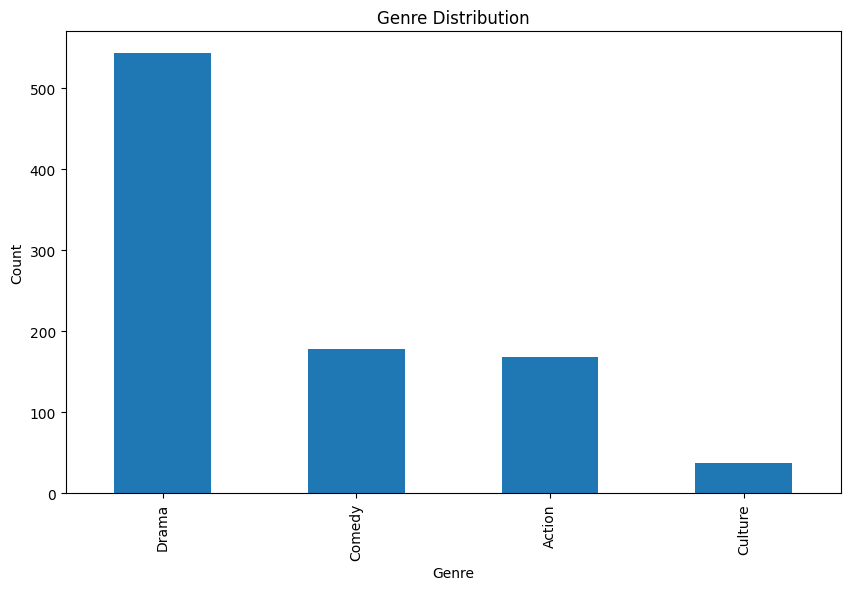

In [20]:
genre_counts = df['New_Genre'].value_counts()
plt.figure(figsize=(10, 6))
genre_counts.plot(kind='bar')
plt.title('Genre Distribution')
plt.xlabel('Genre')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.show()

However, it is crucial to exercise caution when applying resampling methods. While these techniques can help balance the dataset, oversampling should not be excessive, as it may lead to model overfitting due to the model being exposed to repeated instances of the data. If you choose to train your model on an oversampled version of the dataset, ensure that your test dataset remains unaffected by the resampling process. It is recommended to split the data into an 80/20 ratio (train/test) before proceeding with resampling. (seed=42)



In [21]:
# Based on above description, you can modify the given class.
from imblearn.over_sampling import RandomOverSampler

class DataResampling:
    def __init__(self, df, target_col):
        self.df = df
        self.target_col = target_col

    def split_data(self, test_size=0.2, random_state=42):
        """
        Split the dataset into training and testing sets.

        Args:
            test_size (float): The proportion of the dataset to include in the test split (default: 0.2).
            random_state (int): The random seed for reproducibility (default: 42).

        Returns:
            tuple: (X_train, X_test, y_train, y_test)
                X_train (pandas.DataFrame): Training features.
                X_test (pandas.DataFrame): Testing features.
                y_train (pandas.Series): Training target.
                y_test (pandas.Series): Testing target.

        TODO:
        1. Separate the target variable from the features.
        2. Split the dataset into training and testing sets using the provided test_size and random_state.
        3. Return the training and testing features and targets.
        """
        X = self.df.drop(columns=[self.target_col])
        y = self.df[self.target_col]

        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=random_state)

        return X_train, X_train, y_train, y_test

    def resample_data(self, X_train, y_train, random_state=42):
        """
        Apply resampling techniques to balance the training dataset.

        Args:
            X_train (pandas.DataFrame): Training features.
            y_train (pandas.Series): Training target.
            random_state (int): The random seed for reproducibility (default: 42).

        Returns:
            tuple: (X_resampled, y_resampled)
                X_resampled (pandas.DataFrame): Resampled training features.
                y_resampled (pandas.Series): Resampled training target.

        TODO:
        1. Identify the class imbalance in the training data.
        2. Apply appropriate resampling techniques (e.g., RandomOverSampler, SMOTE) to balance the classes.
        3. Return the resampled training features and target.
        """
        class_counts = y_train.value_counts()
        print("Class distribution before resampling:")
        print(class_counts)
        print("-" * 35)

        randomoversampler = RandomOverSampler(random_state=random_state)
        X_resampled, y_resampled = randomoversampler.fit_resample(X_train, y_train)

        resampled_class_counts = y_resampled.value_counts()
        print("Class distribution after resampling:")
        display(resampled_class_counts)

        return X_resampled, y_resampled

target_col = 'New_Genre'
data_resampling = DataResampling(df, target_col)

# TODO: Call the split_data method to split the dataset into training and testing sets
X_train, X_test, y_train, y_test = data_resampling.split_data()

# TODO: Call the resample_data method to resample the training data
X_resampled, y_resampled = data_resampling.resample_data(X_train, y_train)

Class distribution before resampling:
New_Genre
Drama      435
Comedy     143
Action     136
Culture     27
Name: count, dtype: int64
-----------------------------------
Class distribution after resampling:


New_Genre
Action     435
Comedy     435
Culture    435
Drama      435
Name: count, dtype: int64

Additionally, encoding categorical variables is an essential step in feature engineering for machine learning models. Depending on the nature of your categorical features, you may need to apply techniques such as one-hot encoding or label encoding to convert them into a format suitable for model training.

In [22]:
# Feel free to change or modify this function, this is a suggestion.
from sklearn.preprocessing import OneHotEncoder

class CategoricalEncoder:
    def __init__(self, df, categorical_cols):
        self.df = df
        self.categorical_cols = categorical_cols

    def label_encode(self, drop_first=False):
        """
        Apply label encoding to categorical variables.

        Args:
            drop_first (bool): If True, drop the first column of one-hot encoded data to avoid multicollinearity.

        Returns:
            pandas.DataFrame: The DataFrame with categorical variables encoded.

        TODO:
        1. Instantiate a LabelEncoder object.
        2. Iterate through each categorical column.
        3. Fit and transform the categorical column using the LabelEncoder.
        4. Replace the original categorical column with the encoded values.
        5. Return the encoded DataFrame.
        """
        df_encoded = self.df.copy()
        label_encoders = {}

        for col in self.categorical_cols:
            le = LabelEncoder()
            df_encoded[col] = le.fit_transform(df_encoded[col])
            label_encoders[col] = le

        if drop_first:
            df_encoded = df_encoded.drop(columns=self.categorical_cols[0])

        return df_encoded

    def one_hot_encode(self, drop_first=False):
        """
        Apply one-hot encoding to categorical variables.

        Args:
            drop_first (bool): If True, drop the first column of one-hot encoded data to avoid multicollinearity.

        Returns:
            pandas.DataFrame: The DataFrame with categorical variables one-hot encoded.

        TODO:
        1. Instantiate a OneHotEncoder object with the appropriate settings (drop_first=drop_first, handle_unknown='ignore').
        2. Iterate through each categorical column.
        3. Fit and transform the categorical column using the OneHotEncoder.
        4. Concatenate the one-hot encoded columns with the original DataFrame.
        5. Drop the original categorical columns.
        6. Return the one-hot encoded DataFrame.
        """
        df_encoded = self.df.copy()

        for col in self.categorical_cols:
          df_encoded = pd.get_dummies(df_encoded, columns=[col], drop_first=drop_first)

        encoded_cols = df_encoded.select_dtypes(include=['bool'])

        for col in encoded_cols:
          df_encoded[col] = df_encoded[col].map({True: 1, False: 0})

        return df_encoded

categorical_cols = df.select_dtypes(include=['category'])

categorical_encoder = CategoricalEncoder(df, categorical_cols)

# TODO: Call the label_encode method to apply label encoding
df_label_encoded = categorical_encoder.label_encode()
display(df_label_encoded)

# TODO: Call the one_hot_encode method to apply one-hot encoding
df_one_hot_encoded = categorical_encoder.one_hot_encode(drop_first=True)
display(df_one_hot_encoded)

,Link,EN_title,PENGLISH_title,PERSIAN_title,Persian Summary,English Summary,Score,Year,Genre,Time,Preprocessed English,Preprocessed Persian,New_Genre
0,https://www.imvbox.com/watch-persian-movie-ira...,Local Anaesthetic,Bi Hessie Mozeie,بی‌حسی موضعی,جلال‌، دانشجوی سابق رشته فلسفه، متوجه می‌شود خ...,"Jalal, a dropouts philosophy student, realizes...",4.8,2018,6,73,jalal dropout philosophy student realize siste...,جلال دانشجوی سابق رشته فلسفه متوجه میشود خواهر...,3
1,https://www.imvbox.com/watch-persian-movie-ira...,Disturbance,Ashoftegi,آشفته گی,«آشفته‌گی» رئالیستی و اجتماعی نیست. یک فیلم اس...,"After the murder of his rich twin brother, Bar...",3.8,2018,5,78,murder rich twin brother barbod assume identit...,آشفتهگی رئالیستی اجتماعی فیلم عشق جنایت,0
2,https://www.imvbox.com/watch-persian-movie-ira...,Highlight,Haylayt,هایلایت,یک تصادف اتومبیل آدم‌هایی را در تقابل با هم قر...,A man and a woman are have a car accident and ...,4.4,2017,6,77,man woman car accident go coma spouse know two...,تصادف اتومبیل آدمهایی تقابل قرار میدهد مراقبت ...,3
3,https://www.imvbox.com/watch-persian-movie-ira...,Gilda,Geelda,گیلدا,گیلدا ماجرای زنی به نام «گیلدا» را روایت می کن...,Gilda who owns a restaurant has a terrible nig...,3.8,2018,6,79,gilda restaurant terrible night till morning s...,گیلدا ماجرای زنی نام گیلدا روایت صاحب رستوانیس...,3
4,https://www.imvbox.com/watch-persian-movie-ira...,Atmosphere Station,Istgahe Atmosfer,ایستگاه اتمسفر,این فیلم روایت گر داستان زندگی زوج جوانی به اس...,Vahid and Marjan are a young couple who have g...,5.6,2017,6,85,vahid marjan young couple get divorce month ag...,فیلم روایت‌گر داستان زندگی زوج جوانی اسم مرجان...,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1430,https://www.imvbox.com/watch-persian-movie-ira...,The Postman,Postchi,پستچی,"""تقی پستچی "" برای پرداخت قروض خود مجبور است بع...","An impotent, nervous, unbalanced postman, havi...",8.7,1972,6,104,impotent nervous unbalanced postman beautiful ...,تقی پستچی پرداخت قروض مجبور ظهرها نزد نیت الله...,3
1431,https://www.imvbox.com/watch-persian-movie-ira...,Mr. Gullible,Aghaye Haloo,آقای هالو,مردی شهرستانی و ساده دل به قصد یافتن همسری منا...,A simple man from village goes to the big city...,9.3,1971,4,113,simple man village go big city tehran find job...,مردی شهرستانی ساده دل قصد یافتن همسری تهران ته...,1
1432,https://www.imvbox.com/watch-persian-movie-ira...,The Cow,Gav,گاو,"گاو ""مشهدی حسن "" می میرد و او که گاوش را خیلی ...",Often credited as being the first Iranian New ...,8.1,1969,6,100,often credit first iranian new wave film cow w...,گاو مشهدی حسن می‌میرد گاوش دوست متدرجا قالب گا...,3
1435,https://www.imvbox.com/watch-persian-movie-ira...,The Sicilian,Sisiliha,سیسیلی‌ها,سهراب به سیاوش که کلاهبردار است و عاشق ایتالیا...,Though he comes from a poor area south of Tehr...,5.4,2011,5,89,though come poor area south tehran sia always ...,سهراب سیاوش کلاهبردار عاشق ایتالیاست سیا سیسیل...,0


,Link,EN_title,PENGLISH_title,PERSIAN_title,Persian Summary,English Summary,Score,Year,Time,Preprocessed English,...,Genre_Horror,Genre_Human Interest & Society,Genre_Mystery,Genre_Portrait,Genre_Romance,Genre_Thriller,Genre_War,New_Genre_Comedy,New_Genre_Culture,New_Genre_Drama
0,https://www.imvbox.com/watch-persian-movie-ira...,Local Anaesthetic,Bi Hessie Mozeie,بی‌حسی موضعی,جلال‌، دانشجوی سابق رشته فلسفه، متوجه می‌شود خ...,"Jalal, a dropouts philosophy student, realizes...",4.8,2018,73,jalal dropout philosophy student realize siste...,...,0,0,0,0,0,0,0,0,0,1
1,https://www.imvbox.com/watch-persian-movie-ira...,Disturbance,Ashoftegi,آشفته گی,«آشفته‌گی» رئالیستی و اجتماعی نیست. یک فیلم اس...,"After the murder of his rich twin brother, Bar...",3.8,2018,78,murder rich twin brother barbod assume identit...,...,0,0,0,0,0,0,0,0,0,0
2,https://www.imvbox.com/watch-persian-movie-ira...,Highlight,Haylayt,هایلایت,یک تصادف اتومبیل آدم‌هایی را در تقابل با هم قر...,A man and a woman are have a car accident and ...,4.4,2017,77,man woman car accident go coma spouse know two...,...,0,0,0,0,0,0,0,0,0,1
3,https://www.imvbox.com/watch-persian-movie-ira...,Gilda,Geelda,گیلدا,گیلدا ماجرای زنی به نام «گیلدا» را روایت می کن...,Gilda who owns a restaurant has a terrible nig...,3.8,2018,79,gilda restaurant terrible night till morning s...,...,0,0,0,0,0,0,0,0,0,1
4,https://www.imvbox.com/watch-persian-movie-ira...,Atmosphere Station,Istgahe Atmosfer,ایستگاه اتمسفر,این فیلم روایت گر داستان زندگی زوج جوانی به اس...,Vahid and Marjan are a young couple who have g...,5.6,2017,85,vahid marjan young couple get divorce month ag...,...,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1430,https://www.imvbox.com/watch-persian-movie-ira...,The Postman,Postchi,پستچی,"""تقی پستچی "" برای پرداخت قروض خود مجبور است بع...","An impotent, nervous, unbalanced postman, havi...",8.7,1972,104,impotent nervous unbalanced postman beautiful ...,...,0,0,0,0,0,0,0,0,0,1
1431,https://www.imvbox.com/watch-persian-movie-ira...,Mr. Gullible,Aghaye Haloo,آقای هالو,مردی شهرستانی و ساده دل به قصد یافتن همسری منا...,A simple man from village goes to the big city...,9.3,1971,113,simple man village go big city tehran find job...,...,0,0,0,0,0,0,0,1,0,0
1432,https://www.imvbox.com/watch-persian-movie-ira...,The Cow,Gav,گاو,"گاو ""مشهدی حسن "" می میرد و او که گاوش را خیلی ...",Often credited as being the first Iranian New ...,8.1,1969,100,often credit first iranian new wave film cow w...,...,0,0,0,0,0,0,0,0,0,1
1435,https://www.imvbox.com/watch-persian-movie-ira...,The Sicilian,Sisiliha,سیسیلی‌ها,سهراب به سیاوش که کلاهبردار است و عاشق ایتالیا...,Though he comes from a poor area south of Tehr...,5.4,2011,89,though come poor area south tehran sia always ...,...,0,0,0,0,0,0,0,0,0,0


# Fine-tuning

In [33]:
!rm -rf results
!rm -rf logs

In [34]:
torch.cuda.empty_cache()

In [35]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [27]:
class CustomDataset(torch.utils.data.Dataset):
    def __init__(self, encodings, labels):
        self.encodings = encodings
        self.labels = labels

    def __getitem__(self, idx):
        item = {key: torch.tensor(val[idx]) for key, val in self.encodings.items()}
        item['labels'] = torch.tensor(self.labels[idx], dtype=torch.long)
        return item

    def __len__(self):
        return len(self.labels)

## Persian

In [28]:
# load pre-trained ParsBERT model and its tokenizer
from transformers import AutoTokenizer, AutoModelForSequenceClassification
from sklearn.preprocessing import LabelEncoder

tokenizer = AutoTokenizer.from_pretrained("HooshvareLab/bert-fa-zwnj-base")
model = AutoModelForSequenceClassification.from_pretrained("HooshvareLab/bert-fa-zwnj-base", num_labels=4)
model.to(device)

tokenizer_config.json:   0%|          | 0.00/292 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/426k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.11M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/134 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/473M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at HooshvareLab/bert-fa-zwnj-base and are newly initialized: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight', 'classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


BertForSequenceClassification(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(42000, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0-11): 12 x BertLayer(
          (attention): BertAttention(
            (self): BertSdpaSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e

### Preprocessed

In [29]:
# Choose train and test data from preprocessed persian data
# tokenize train and test data with max_length 512
label_encoder = LabelEncoder()

train_encodings = tokenizer(list(X_resampled['Preprocessed Persian']), truncation=True, padding=True, max_length=512)
test_encodings = tokenizer(list(X_test['Preprocessed Persian']), truncation=True, padding=True, max_length=512)

train_dataset = CustomDataset(train_encodings, label_encoder.fit_transform(y_resampled))
test_dataset = CustomDataset(test_encodings, label_encoder.transform(y_test))


In [36]:
from sklearn.metrics import accuracy_score, precision_recall_fscore_support

# Train the model using huggingface trainer
num_epochs = 5
from transformers import Trainer, TrainingArguments

def compute_metrics(eval_pred):
    logits, labels = eval_pred
    predictions = np.argmax(logits, axis=-1)
    return {"accuracy": accuracy_score(labels, predictions)}

# Define the Trainer
training_args = TrainingArguments(
    output_dir="./results",
    num_train_epochs=num_epochs,
    per_device_train_batch_size=4,
    per_device_eval_batch_size=4,
    warmup_steps=500,
    weight_decay=0.1,
    logging_dir='./logs',
    logging_steps=10,
    eval_strategy="epoch",
    save_strategy="epoch",
    load_best_model_at_end=True,
    greater_is_better=True,
    metric_for_best_model='accuracy',
)

trainer = Trainer(
    model=model,
    train_dataset=train_dataset,         # training dataset
    args = training_args,
    eval_dataset=test_dataset ,
    compute_metrics=compute_metrics
)

# Train the model
trainer.train()

Epoch,Training Loss,Validation Loss,Accuracy
1,0.886800,5.502611,0.440860
2,0.041500,5.978440,0.392473
3,0.000100,6.116303,0.408602


Epoch,Training Loss,Validation Loss,Accuracy
1,0.886800,5.502611,0.440860
2,0.041500,5.978440,0.392473
3,0.000100,6.116303,0.408602
4,0.000100,6.512085,0.403226
5,0.000000,6.637613,0.403226


TrainOutput(global_step=2175, training_loss=0.09794903495303495, metrics={'train_runtime': 712.3172, 'train_samples_per_second': 12.214, 'train_steps_per_second': 3.053, 'total_flos': 1783894155170400.0, 'train_loss': 0.09794903495303495, 'epoch': 5.0})

In [37]:
# Calulate the Accuracy and F1-score for test data
# Draw Confusion matrix according to all genres
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix


def display_matrix(matrix):
    print('Confusion Matrix:')
    print(matrix)

def display_metrics(accuracy, f1score):
    print('Accuracy: ', accuracy)
    print('F1 Score: ', f1score)

predictions = trainer.predict(test_dataset)
y_pred = np.argmax(predictions.predictions, axis=1)

matrix = confusion_matrix(label_encoder.transform(y_test), y_pred)
accuracy = accuracy_score(label_encoder.transform(y_test), y_pred)
f1score = f1_score(label_encoder.transform(y_test), y_pred, average='weighted')

display_metrics(accuracy, f1score)
display_matrix(matrix)

Accuracy:  0.44086021505376344
F1 Score:  0.41873377827215424
Confusion Matrix:
[[ 6  4  1 21]
 [ 5  3  3 24]
 [ 1  2  1  7]
 [20 12  4 72]]


### Not Preprocessed


In [38]:
# Repeat all the previous steps for the raw persian data
# Don't forget to load the model again
tokenizer = AutoTokenizer.from_pretrained("HooshvareLab/bert-fa-zwnj-base")
model = AutoModelForSequenceClassification.from_pretrained("HooshvareLab/bert-fa-zwnj-base", num_labels=4)
model.to(device)
label_encoder = LabelEncoder()

train_encodings = tokenizer(list(X_resampled['Preprocessed Persian']), truncation=True, padding=True, max_length=512)
test_encodings = tokenizer(list(X_test['Preprocessed Persian']), truncation=True, padding=True, max_length=512)

train_dataset = CustomDataset(train_encodings, label_encoder.fit_transform(y_resampled))
test_dataset = CustomDataset(test_encodings, label_encoder.transform(y_test))

trainer = Trainer(
    model=model,
    train_dataset=train_dataset,         # training dataset
    args = training_args,
    eval_dataset=test_dataset,
    compute_metrics=compute_metrics
)

# Train the model
trainer.train()

predictions = trainer.predict(test_dataset)
y_pred = np.argmax(predictions.predictions, axis=1)

matrix = confusion_matrix(label_encoder.transform(y_test), y_pred)
accuracy = accuracy_score(label_encoder.transform(y_test), y_pred)
f1score = f1_score(label_encoder.transform(y_test), y_pred, average='weighted')

display_metrics(accuracy, f1score)
display_matrix(matrix)

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at HooshvareLab/bert-fa-zwnj-base and are newly initialized: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight', 'classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.631000,2.105119,0.392473
2,0.275300,3.994034,0.419355
3,0.000400,5.405026,0.408602
4,0.000200,5.902494,0.403226
5,0.000200,6.014381,0.403226


Accuracy:  0.41935483870967744
F1 Score:  0.41570582997705324
Confusion Matrix:
[[ 5  9  1 17]
 [ 5  8  1 21]
 [ 0  2  1  8]
 [19 22  3 64]]


## English


In [39]:
# load  pre-trained BERT model and its tokenizer
from transformers import BertTokenizer, BertForSequenceClassification
from sklearn.preprocessing import LabelEncoder

tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=4)
model.to(device)

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


BertForSequenceClassification(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0-11): 12 x BertLayer(
          (attention): BertAttention(
            (self): BertSdpaSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e

### Preprocessed

In [40]:
# Repeat all the needed steps for the preprocessed english data

train_encodings = tokenizer(list(X_resampled['Preprocessed English']), truncation=True, padding=True, max_length=512)
test_encodings = tokenizer(list(X_test['Preprocessed English']), truncation=True, padding=True, max_length=512)

train_dataset = CustomDataset(train_encodings, label_encoder.fit_transform(y_resampled))
test_dataset = CustomDataset(test_encodings, label_encoder.transform(y_test))

trainer = Trainer(
    model=model,
    train_dataset=train_dataset,         # training dataset
    args = training_args,
    eval_dataset=test_dataset,
    compute_metrics=compute_metrics
)

# Train the model
trainer.train()

predictions = trainer.predict(test_dataset)
y_pred = np.argmax(predictions.predictions, axis=1)

matrix = confusion_matrix(label_encoder.transform(y_test), y_pred)
accuracy = accuracy_score(label_encoder.transform(y_test), y_pred)
f1score = f1_score(label_encoder.transform(y_test), y_pred, average='weighted')

display_metrics(accuracy, f1score)
display_matrix(matrix)

Epoch,Training Loss,Validation Loss,Accuracy
1,0.793000,1.934267,0.252688
2,0.437900,3.462463,0.392473
3,0.163200,4.481746,0.408602
4,0.001900,4.977065,0.403226
5,0.000500,5.264942,0.403226


Accuracy:  0.40860215053763443
F1 Score:  0.40111557331671177
Confusion Matrix:
[[ 5  7  1 19]
 [ 6  5  1 23]
 [ 1  2  1  7]
 [21 19  3 65]]


### Not Preprocessed


In [41]:
# Repeat all the previous steps for the raw english data
# Don't forget to load the model again
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=4)
model.to(device)

train_encodings = tokenizer(list(X_resampled['English Summary']), truncation=True, padding=True, max_length=512)
test_encodings = tokenizer(list(X_test['English Summary']), truncation=True, padding=True, max_length=512)

train_dataset = CustomDataset(train_encodings, label_encoder.fit_transform(y_resampled))
test_dataset = CustomDataset(test_encodings, label_encoder.transform(y_test))

trainer = Trainer(
    model=model,
    train_dataset=train_dataset,         # training dataset
    args = training_args,
    eval_dataset=test_dataset,
    compute_metrics=compute_metrics
)

# Train the model
trainer.train()

predictions = trainer.predict(test_dataset)
y_pred = np.argmax(predictions.predictions, axis=1)

matrix = confusion_matrix(label_encoder.transform(y_test), y_pred)
accuracy = accuracy_score(label_encoder.transform(y_test), y_pred)
f1score = f1_score(label_encoder.transform(y_test), y_pred, average='weighted')

display_metrics(accuracy, f1score)
display_matrix(matrix)

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.995900,2.007059,0.354839
2,0.193700,4.043450,0.376344
3,0.057000,4.735908,0.408602
4,0.007300,5.493149,0.403226
5,0.000300,5.582434,0.403226


Accuracy:  0.40860215053763443
F1 Score:  0.4035802293206798
Confusion Matrix:
[[ 5  7  1 19]
 [ 6  6  1 22]
 [ 1  2  1  7]
 [22 19  3 64]]


## Results Analysis

Analyze the results of the Fine-tuning section.


In this part we tried different hyper parameters and checked the result for each of them. The accuracy for different parameteres was different. we choose the one has more accuracy and smaller amount of loss for both train and eval datasets. then we use test dataset and compute its confusion matrix and f1 score.
